In [2]:
library(mice)
library(finalfit)
library(ggplot2)
library(dplyr)
library(stats)
library(miceadds)
library(missMethods)
library(smotefamily)
library(caret)
library(cowplot)
library(mlr)
library(fastDummies)
library(DMwR2)
library(mlmi)
library(ranger)
library(scales)

Warning message:
"pakiet 'mice' został zbudowany w wersji R 4.3.2"

Dołączanie pakietu: 'mice'


Następujący obiekt został zakryty z 'package:stats':

    filter


Następujące obiekty zostały zakryte z 'package:base':

    cbind, rbind


Warning message:
"pakiet 'ggplot2' został zbudowany w wersji R 4.3.3"

Dołączanie pakietu: 'dplyr'


Następujące obiekty zostały zakryte z 'package:stats':

    filter, lag


Następujące obiekty zostały zakryte z 'package:base':

    intersect, setdiff, setequal, union


* miceadds 3.16-18 (2023-01-06 10:54:00)

Ładowanie wymaganego pakietu: lattice

Warning message:
"pakiet 'cowplot' został zbudowany w wersji R 4.3.2"
Warning message:
"pakiet 'mlr' został zbudowany w wersji R 4.3.2"
Ładowanie wymaganego pakietu: ParamHelpers

Warning message:
"pakiet 'ParamHelpers' został zbudowany w wersji R 4.3.2"
Warning message: 'mlr' is in 'maintenance-only' mode since July 2019.
Future development will only happen in 'mlr3'
(<https://mlr3.mlr-org.com>). Due to t

### Functions definitions

In [3]:
visImpCont <- function(orig_train, orig_test, imp_train, imp_test, miss_var, imp_type) {
    #' Visualize imputation of missing data for continuous variable.

    orig_data <- rbind(orig_train, orig_test)
    orig_data <- orig_data[order(orig_data$index),]
    imp_data <- rbind(imp_train, imp_test)
    imp_data <- imp_data[order(imp_data$index),]

    miss_ind <- which(is.na(orig_data[[miss_var]]))
    imp_data$imputed <- "Observed"
    imp_data$imputed[miss_ind] <- "Imputed"

    ggplot(data = imp_data, aes(x = index, y = !!as.name(miss_var), color = imputed)) +
        geom_point(data = subset(imp_data, imputed == "Observed"), size = 3, alpha = 0.8) +
        geom_point(data = subset(imp_data, imputed == "Imputed"), size = 3) +
        scale_color_manual(values = c("steelblue1", "royalblue4")) +
        ggtitle(paste(miss_var, imp_type, "imputation")) +
        theme(
            plot.title = element_text(size = 26),
            axis.title = element_text(size = 22),         
            axis.text.x = element_text(size = 18),        
            axis.text.y = element_text(size = 18),
            legend.text = element_text(size = 16),        
            legend.title = element_text(size = 18))
}

In [4]:
visImpCat <- function(orig_train, orig_test, imp_train, imp_test, miss_var, imp_type) {
    #' Visualize imputation of missing data for categorical variable.

    orig_data <- rbind(orig_train, orig_test)
    orig_data <- orig_data[order(orig_data$index),]
    imp_data <- rbind(imp_train, imp_test)
    imp_data <- imp_data[order(imp_data$index),]

    miss_ind <- which(is.na(orig_data[[miss_var]]))
    imp_data$imputed <- "Observed"
    imp_data$imputed[miss_ind] <- "Imputed"

    ggplot(data = imp_data, aes(x = !!as.name(miss_var), fill = imputed)) +
        geom_bar() +
        scale_fill_manual(values = c("steelblue1", "royalblue4")) +
        ggtitle(paste(miss_var, imp_type, "imputation")) +
        theme(
            plot.title = element_text(size = 26),
            axis.title = element_text(size = 22),         
            axis.text.x = element_text(size = 18),        
            axis.text.y = element_text(size = 18),
            legend.text = element_text(size = 16),        
            legend.title = element_text(size = 18))
}

In [5]:
visImpMul <- function(orig_train, orig_test, imp_train, imp_test, miss_var, imp_type) {
    #' Visualize imputation of missing data for continuous variable (multiple imputation).

    orig_data <- rbind(orig_train, orig_test)
    orig_data <- orig_data[order(orig_data$index),]
    imp_data <- rbind(imp_train, imp_test)
    imp_data <- imp_data[order(imp_data$index),]

    miss_ind <- which(is.na(orig_data[[miss_var]]))
    imp_data$imputed <- "Observed"
    imp_data$imputed[miss_ind] <- "Imputed"

    p <- ggplot(data = imp_data, aes(x = index, y = !!as.name(miss_var), color = imputed)) +
        geom_point(data = subset(imp_data, imputed == "Observed"), size = 3, alpha = 0.8) +
        geom_point(data = subset(imp_data, imputed == "Imputed"), size = 3) +
        scale_color_manual(values = c("steelblue1", "royalblue4")) +
        ggtitle(paste(miss_var, imp_type, "imputation")) +
        theme(
            plot.title = element_text(size = 26),
            axis.title = element_text(size = 22),         
            axis.text.x = element_text(size = 18),        
            axis.text.y = element_text(size = 18),
            legend.text = element_text(size = 16),        
            legend.title = element_text(size = 18),
            strip.text = element_text(size = 18))

    p + facet_wrap(~ .imp, ncol = 2, scales="free")
}

In [6]:
visImpMulCat <- function(orig_train, orig_test, imp_train, imp_test, miss_var, imp_type) {
    #' Visualize imputation of missing data for categorical variable (multiple imputation).

    orig_data <- rbind(orig_train, orig_test)
    orig_data <- orig_data[order(orig_data$index),]
    imp_data <- rbind(imp_train, imp_test)
    imp_data <- imp_data[order(imp_data$index),]

    miss_ind <- which(is.na(orig_data[[miss_var]]))
    imp_data$imputed <- "Observed"
    imp_data$imputed[miss_ind] <- "Imputed"

    p <- ggplot(data = imp_data, aes(x = !!as.name(miss_var), fill = imputed)) +
        geom_bar() +
        scale_fill_manual(values = c("steelblue1", "royalblue4")) +
        ggtitle(paste(miss_var, imp_type, "imputation")) +
        theme(
            plot.title = element_text(size = 26),
            axis.title = element_text(size = 22),         
            axis.text.x = element_text(size = 18),        
            axis.text.y = element_text(size = 18),
            legend.text = element_text(size = 16),        
            legend.title = element_text(size = 18),
            strip.text = element_text(size = 18))

    p + facet_wrap(~ .imp, ncol = 2, scales="free")
}

In [7]:
balancedTrain <- function(trainset, tgt_cls, fcols, multiple = FALSE) {
    #' Oversample minority class, return balanced training set.

    trainset <- dummy_cols(trainset, select_columns = fcols)
    trainset <- trainset[, !names(trainset) %in% fcols]
    
    if (multiple == TRUE) {
        trainset <- subset(trainset, select = -c(.imp))
    }
    
    feature_cols <- setdiff(colnames(trainset), tgt_cls)
    adas <- ADAS(trainset[, feature_cols], trainset[[tgt_cls]])
    balanced <- adas$data
    colnames(balanced)[colnames(balanced) == "class"] <- tgt_cls
    
    return (balanced)
}

In [8]:
numericTest <- function(testset, fcols) {
    #' Convert all categorical features in test set to numeric (except target class).

    testset <- dummy_cols(testset, select_columns = fcols)
    testset <- testset[, !names(testset) %in% fcols]
    
    return(testset)
}

In [9]:
scaleDataSet <- function(dataset, tgt_cls, multiple=FALSE) {
    #' Scale all data to [0, 1] range.

    tgt_class <- dataset[[tgt_cls]]

    if (multiple == TRUE) {
        imp_col <- dataset$.imp
        feature_cols <- setdiff(colnames(dataset), c(tgt_cls, ".imp"))
        data_cols <- dataset[, feature_cols]
        scaled_data <- as.data.frame(lapply(data_cols, FUN = rescale))
        scaled_data$.imp <- imp_col
        scaled_data[[tgt_cls]] <- tgt_class
    }
    else {
        feature_cols <- setdiff(colnames(dataset), tgt_cls)
        data_cols <- dataset[, feature_cols]
        scaled_data <- as.data.frame(lapply(data_cols, FUN = rescale))
        scaled_data[[tgt_cls]] <- tgt_class
    }

    return(scaled_data)
}

In [10]:
create_zero_df <- function(num_rows, num_cols, colnames) {
  #' Create dataframe of zeros.
  
  df <- as.data.frame(matrix(0, nrow = num_rows, ncol = num_cols))
  names(df) <- colnames
  return(df)
}

In [11]:
check_data <- function(data) {
  #' Check if data has any NA/NaN/Inf values.

  !any(sapply(data, function(x) any(is.na(x) | is.nan(x) | is.infinite(x))))
}

In [12]:
classify <- function(tgt_cls, balanced, numtest) {
    #' Apply the four classification algorithms.

    glm <- caret::train(as.formula(paste(tgt_cls, "~ .")), data = balanced, method = "glm")
    glm_pred <- predict(glm, newdata = numtest)

    knn_grid <- data.frame(k=seq(1, 10, by=1))
    knn_control <- trainControl(method = "cv", number = 5)
    knn <- caret::train(as.formula(paste(tgt_cls, "~ .")), data = balanced, method = "knn", trControl = knn_control, tuneGrid = knn_grid)
    knn_pred <- predict(knn, newdata = numtest)

    ct <- makeClassifTask(id = "mcar", data = balanced, target = tgt_cls)
    cv <- makeResampleDesc("CV", iters = 5)
    lrn <- makeLearner("classif.rpart")
    cg <- makeTuneControlGrid()
    ps <- makeParamSet(
    makeDiscreteParam("cp", values = seq(0.01, 0.6, by = 0.1)),
    makeDiscreteParam("minbucket", values = c(3, 7, 10)),
    makeDiscreteParam("maxdepth", values = seq(5, 30, by = 5)))
    tunedt <- tuneParams(lrn, task = ct, resampling = cv, control = cg, par.set = ps, measures = acc)
    dtparams <- tunedt$x
    opt_lrn <- setHyperPars(lrn, par.vals = dtparams)
    dt <- mlr::train(opt_lrn, ct)
    dt_pred <- predict(dt, newdata = numtest)$data$response

    rf_grid <- expand.grid(mtry = seq(1, 15))
    rf_control <- trainControl(method ="cv", number=5)
    rf <- caret::train(as.formula(paste(tgt_cls, "~ .")), data = balanced, method = "rf", trControl = rf_control, tuneGrid = rf_grid, ntree=100)
    rf_pred <- predict(rf, newdata = numtest)

    return(list(glm_pred=glm_pred, knn_pred=knn_pred, dt_pred=dt_pred, rf_pred=rf_pred))
}

In [13]:
simulate <- function(dataset, tgt_cls, nsim, method, m, maxit, filename, intcols, fcols) {
    #' Simulate classification on data imputed with mice package methods.

    predm <- make.predictorMatrix(dataset)
    res <- create_zero_df(nsim, 4, c("glm", "knn", "dt", "rf"))
    filecon <- file(filename, "w")
    on.exit({close(filecon)}, add = TRUE)
    
    for (n in 1:nsim) {

        good_test <- FALSE
        good_data <- FALSE
        good_pred <- FALSE
 
        if (m==1) {

            while (!good_pred) {

                while (!(good_test && good_data)) {
                    train_ind <- createDataPartition(dataset[[tgt_cls]], p = 0.75, list = FALSE)
                    train <- dataset[train_ind,]
                    test  <- dataset[-train_ind,]
                    imp_train <- mice(train, method=method, m=m, maxit=maxit, predictorMatrix=predm) %>% complete()
                    imp_test <- mice(test, method=method, m=m, maxit=maxit, predictorMatrix=predm) %>% complete()
                    good_test <- length(unique(imp_test[[tgt_cls]])) == 2

                    balanced <- balancedTrain(imp_train, tgt_cls, fcols)
                    numtest <- numericTest(imp_test, fcols)
                    balanced[intcols] <- balanced[intcols] %>% lapply(as.integer)
                    balanced <- scaleDataSet(balanced, tgt_cls)
                    numtest <- scaleDataSet(numtest, tgt_cls)
                    good_data <- (check_data(balanced) && check_data(numtest))
                }

                preds <- classify(tgt_cls, balanced, numtest)
                good_glm <- length(unique(preds$glm_pred)) == 2
                good_knn <- length(unique(preds$knn_pred)) == 2
                good_dt <- length(unique(preds$dt_pred)) == 2
                good_rf <- length(unique(preds$rf_pred)) == 2
                good_pred <- good_glm && good_knn && good_dt && good_rf
                good_data <- FALSE
                good_test <- FALSE
            }

            glm_cm <- confusionMatrix(numtest[[tgt_cls]], preds$glm_pred)
            res[n, 1] <- as.numeric(glm_cm$overall[1])

            knn_cm <- confusionMatrix(numtest[[tgt_cls]], preds$knn_pred)
            res[n, 2] <- as.numeric(knn_cm$overall[1])

            dt_cm <- confusionMatrix(numtest[[tgt_cls]], preds$dt_pred)
            res[n, 3] <- as.numeric(dt_cm$overall[1])

            rf_cm <- confusionMatrix(numtest[[tgt_cls]], preds$rf_pred)
            res[n, 4] <- as.numeric(rf_cm$overall[1])

            write.table(res[n, ], filecon, sep = ",", row.names = FALSE, col.names = FALSE, append = TRUE)
            flush(filecon)

        }
        else {
            glm_pred <- list()
            knn_pred <- list()
            dt_pred <- list()
            rf_pred <- list()

            while (!good_pred) {

                while (!(good_test && good_data)) {
                    train_ind <- createDataPartition(dataset[[tgt_cls]], p = 0.75, list = FALSE)
                    train <- dataset[train_ind,]
                    test  <- dataset[-train_ind,]
                    imp_train <- mice(train, method=method, m=m, maxit=maxit, predictorMatrix=predm) %>% complete(action="long")
                    imp_test <- mice(test, method=method, m=m, maxit=maxit, predictorMatrix=predm) %>% complete(action="long")
                    good_test <- length(unique(imp_test[[tgt_cls]])) == 2

                    balanced <- balancedTrain(subset(imp_train, .imp == 1), tgt_cls, fcols)
                    balanced$.imp <- 1
                    numtest <- numericTest(imp_test, fcols)
                    numtest <- scaleDataSet(numtest, tgt_cls, multiple=TRUE)
                    tst <- subset(numtest, .imp == 1)

                    for (i in 2:m) {
                        imptr <- subset(imp_train, .imp == i)
                        btr <- balancedTrain(imptr, tgt_cls, fcols)
                        btr$.imp <- i
                        balanced <- rbind(balanced, btr)
                    }

                    balanced[intcols] <- balanced[intcols] %>% lapply(as.integer)
                    balanced <- scaleDataSet(balanced, tgt_cls, multiple=TRUE)
                    good_data <- (check_data(balanced) && check_data(numtest))
                }

                for (i in 1:m) {
                    trn <- subset(balanced, .imp == i)
                    preds <- classify(tgt_cls, trn, tst)
                    glm_pred[[i]] <- preds$glm_pred
                    knn_pred[[i]] <- preds$knn_pred
                    dt_pred[[i]] <- preds$dt_pred
                    rf_pred[[i]] <- preds$rf_pred
                }

                glm_pred <- lapply(glm_pred, function(x) as.numeric(as.character(x)))
                mv_glm <- as.factor(as.integer(colMeans(do.call(rbind, glm_pred)) > 0.5))
                good_glm <- length(unique(mv_glm)) == 2

                knn_pred <- lapply(knn_pred, function(x) as.numeric(as.character(x)))
                mv_knn <- as.factor(as.integer(colMeans(do.call(rbind, knn_pred)) > 0.5))
                good_knn <- length(unique(mv_knn)) == 2

                dt_pred <- lapply(dt_pred, function(x) as.numeric(as.character(x)))
                mv_dt <- as.factor(as.integer(colMeans(do.call(rbind, dt_pred)) > 0.5))
                good_dt <- length(unique(mv_dt)) == 2

                rf_pred <- lapply(rf_pred, function(x) as.numeric(as.character(x)))
                mv_rf <- as.factor(as.integer(colMeans(do.call(rbind, rf_pred)) > 0.5))
                good_rf <- length(unique(mv_rf)) == 2

                good_pred <- good_glm && good_knn && good_dt && good_rf
                good_data <- FALSE
                good_test <- FALSE 
            }

            glm_cm <- confusionMatrix(tst[[tgt_cls]], mv_glm)
            res[n, 1] <- as.numeric(glm_cm$overall[1])
            
            knn_cm <- confusionMatrix(tst[[tgt_cls]], mv_knn)
            res[n, 2] <- as.numeric(knn_cm$overall[1])

            dt_cm <- confusionMatrix(tst[[tgt_cls]], mv_dt)
            res[n, 3] <- as.numeric(dt_cm$overall[1])

            rf_cm <- confusionMatrix(tst[[tgt_cls]], mv_rf)
            res[n, 4] <- as.numeric(rf_cm$overall[1])

            write.table(res[n, ], filecon, sep = ",", row.names = FALSE, col.names = FALSE, append = TRUE)
            flush(filecon)
        }
    }

    return(colMeans(res))
}

In [14]:
simulate_knn <- function(dataset, tgt_cls, nsim, filename, intcols, fcols) {
    #' Simulate classification on data imputed with KNN.

    res <- create_zero_df(nsim, 4, c("glm", "knn", "dt", "rf"))
    filecon <- file(filename, "w")
    on.exit({close(filecon)}, add = TRUE)

    for (n in 1:nsim) {

        good_test <- FALSE
        good_data <- FALSE
        good_pred <- FALSE

        while(!good_pred) {

            while (!(good_test && good_data)) {
                train_ind <- createDataPartition(dataset[[tgt_cls]], p = 0.75, list = FALSE)
                train <- dataset[train_ind,]
                test  <- dataset[-train_ind,]
                imp_train <- knnImputation(train, scale=FALSE)
                imp_test <- knnImputation(test, scale=FALSE)
                good_test <- length(unique(imp_test[[tgt_cls]])) == 2

                balanced <- balancedTrain(imp_train, tgt_cls, fcols)
                numtest <- numericTest(imp_test, fcols)
                balanced[intcols] <- balanced[intcols] %>% lapply(as.integer)
                balanced <- scaleDataSet(balanced, tgt_cls)
                numtest <- scaleDataSet(numtest, tgt_cls)
                good_data <- (check_data(balanced) && check_data(numtest))          
            }

            preds <- classify(tgt_cls, balanced, numtest)
            good_glm <- length(unique(preds$glm_pred)) == 2
            good_knn <- length(unique(preds$knn_pred)) == 2
            good_dt <- length(unique(preds$dt_pred)) == 2
            good_rf <- length(unique(preds$rf_pred)) == 2
            good_pred <- good_glm && good_knn && good_dt && good_rf
            good_data <- FALSE
            good_test <- FALSE
        }

        glm_cm <- confusionMatrix(numtest[[tgt_cls]], preds$glm_pred)
        res[n, 1] <- as.numeric(glm_cm$overall[1])

        knn_cm <- confusionMatrix(numtest[[tgt_cls]], preds$knn_pred)
        res[n, 2] <- as.numeric(knn_cm$overall[1])

        dt_cm <- confusionMatrix(numtest[[tgt_cls]], preds$dt_pred)
        res[n, 3] <- as.numeric(dt_cm$overall[1])

        rf_cm <- confusionMatrix(numtest[[tgt_cls]], preds$rf_pred)
        res[n, 4] <- as.numeric(rf_cm$overall[1])

        write.table(res[n, ], filecon, sep = ",", row.names = FALSE, col.names = FALSE, append = TRUE)
        flush(filecon)
    }

    return(colMeans(res))
}

In [15]:
simulate_mlmi <- function(dataset, tgt_cls, nsim, m, filename, intcols, fcols, fcols_class) {
    #' Simulate classification on data imputed with MLMI.

    res <- create_zero_df(nsim, 4, c("glm", "knn", "dt", "rf"))
    filecon <- file(filename, "w")
    on.exit({close(filecon)}, add = TRUE)

    for (n in 1:nsim) {

        good_test <- FALSE
        good_data <- FALSE
        good_pred <- FALSE

        while(!good_pred) {

            while (!(good_test && good_data)) {
                train_ind <- createDataPartition(dataset[[tgt_cls]], p = 0.75, list = FALSE)
                train <- dataset[train_ind,]
                test  <- dataset[-train_ind,]

                cattrain <- train[, (names(train) %in% fcols_class)]
                cattest <- test[, (names(test) %in% fcols_class)]
                conttrain <- train[, !(names(train) %in% colnames(cattrain))]
                conttest <- test[, !(names(test) %in% colnames(cattest))]

                train <- cbind(cattrain, conttrain)
                test <- cbind(cattest, conttest)
                train[] <- lapply(train, function(x) if(is.factor(x)) as.integer(x) else x)
                test[] <- lapply(test, function(x) if(is.factor(x)) as.integer(x) else x)

                imp_train <- mixImp(obsData = train, nCat = 8, M = m, rseed = 1234)
                imp_test <- mixImp(obsData = test, nCat = 8, M = m, rseed = 1234)

                imp_train_df <- imp_train[[1]]
                imp_test_df <- imp_test[[1]]
                imp_train_df$.imp <- 1
                imp_test_df$.imp <- 1

                for (i in 2:m) {
                    imp_train_i <- imp_train[[i]]
                    imp_train_i$.imp <- i
                    imp_train_df <- rbind(imp_train_df, imp_train_i)

                    imp_test_i <- imp_test[[i]]
                    imp_test_i$.imp <- i
                    imp_test_df <- rbind(imp_test_df, imp_test_i)
                }

                imp_train_df[fcols_class] <- imp_train_df[fcols_class] %>% lapply(factor)
                imp_test_df[fcols_class] <- imp_test_df[fcols_class] %>% lapply(factor)

                bcols <- fcols_class[sapply(dataset[fcols_class], function(x) nlevels(as.factor(x)) == 2)]

                for (col in bcols) {
                    imp_train_df[[col]] <- ifelse(imp_train_df[[col]] == 1, levels(dataset[[col]])[1], levels(dataset[[col]])[2])
                    imp_test_df[[col]] <- ifelse(imp_test_df[[col]] == 1, levels(dataset[[col]])[1], levels(dataset[[col]])[2])
                }

                imp_train_df[fcols_class] <- imp_train_df[fcols_class] %>% lapply(factor)
                imp_test_df[fcols_class] <- imp_test_df[fcols_class] %>% lapply(factor)
                imp_train_df[intcols] <- imp_train_df[intcols] %>% lapply(as.integer)
                imp_test_df[intcols] <- imp_test_df[intcols] %>% lapply(as.integer)

                good_test <- length(unique(imp_test_df[[tgt_cls]])) == 2
                
                balanced <- balancedTrain(subset(imp_train_df, .imp == 1), tgt_cls, fcols)
                balanced$.imp <- 1
                numtest <- numericTest(imp_test_df, fcols)
                numtest <- scaleDataSet(numtest, tgt_cls, multiple=TRUE)
                tst <- subset(numtest, .imp == 1)

                for (i in 2:m) {
                    imptr <- subset(imp_train_df, .imp == i)
                    btr <- balancedTrain(imptr, tgt_cls, fcols)
                    btr$.imp <- i
                    balanced <- rbind(balanced, btr)
                }

                balanced[intcols] <- balanced[intcols] %>% lapply(as.integer)
                balanced <- scaleDataSet(balanced, tgt_cls, multiple=TRUE)

                good_data <- (check_data(balanced) && check_data(numtest))             
            }

            glm_pred <- list()
            knn_pred <- list()
            dt_pred <- list()
            rf_pred <- list()

            for (i in 1:m) {
                trn <- subset(balanced, .imp == i)
                preds <- classify(tgt_cls, trn, tst)
                glm_pred[[i]] <- preds$glm_pred
                knn_pred[[i]] <- preds$knn_pred
                dt_pred[[i]] <- preds$dt_pred
                rf_pred[[i]] <- preds$rf_pred
            }

            glm_pred <- lapply(glm_pred, function(x) as.numeric(as.character(x)))
            mv_glm <- as.factor(as.integer(colMeans(do.call(rbind, glm_pred)) > 0.5))
            good_glm <- length(unique(mv_glm)) == 2

            knn_pred <- lapply(knn_pred, function(x) as.numeric(as.character(x)))
            mv_knn <- as.factor(as.integer(colMeans(do.call(rbind, knn_pred)) > 0.5))
            good_knn <- length(unique(mv_knn)) == 2

            dt_pred <- lapply(dt_pred, function(x) as.numeric(as.character(x)))
            mv_dt <- as.factor(as.integer(colMeans(do.call(rbind, dt_pred)) > 0.5))
            good_dt <- length(unique(mv_dt)) == 2

            rf_pred <- lapply(rf_pred, function(x) as.numeric(as.character(x)))
            mv_rf <- as.factor(as.integer(colMeans(do.call(rbind, rf_pred)) > 0.5))
            good_rf <- length(unique(mv_rf)) == 2

            good_pred <- good_glm && good_knn && good_dt && good_rf
            good_data <- FALSE
            good_test <- FALSE
        }

        glm_cm <- confusionMatrix(tst[[tgt_cls]], mv_glm)
        res[n, 1] <- as.numeric(glm_cm$overall[1])

        knn_cm <- confusionMatrix(tst[[tgt_cls]], mv_knn)
        res[n, 2] <- as.numeric(knn_cm$overall[1])

        dt_cm <- confusionMatrix(tst[[tgt_cls]], mv_dt)
        res[n, 3] <- as.numeric(dt_cm$overall[1])

        rf_cm <- confusionMatrix(tst[[tgt_cls]], mv_rf)
        res[n, 4] <- as.numeric(rf_cm$overall[1])

        write.table(res[n, ], filecon, sep = ",", row.names = FALSE, col.names = FALSE, append = TRUE)
        flush(filecon)
    }

    return(colMeans(res))
}

### Missing data imputation + classification

In [16]:
fram <- read.csv("Framingham.csv")
fram_mar <- read.csv("fram_mar.csv")

In [17]:
fcols <- c("male", "education", "currentSmoker", "BPMeds", "prevalentStroke", "prevalentHyp", "diabetes", "TenYearCHD")
fcols2 <- c("male", "education", "currentSmoker", "BPMeds", "prevalentStroke", "prevalentHyp", "diabetes")
ccols <- c("age", "cigsPerDay", "totChol", "sysBP", "diaBP", "BMI", "heartRate", "glucose")
intcols <- c("age", "cigsPerDay", "totChol", "heartRate", "glucose")

In [18]:
fram_mar[fcols] <- fram_mar[fcols] %>% lapply(factor)
fram_mar_vis <- fram_mar
fram_mar_vis$index <- as.numeric(row.names(fram_mar_vis))

In [19]:
set.seed(1234)
train_ind <- createDataPartition(fram_mar_vis$TenYearCHD, p = 0.75, list = FALSE)

In [20]:
train <- fram_mar_vis[train_ind,]
test  <- fram_mar_vis[-train_ind,]

In [21]:
predm_train <- make.predictorMatrix(train)
predm_train[,"index"] <- 0
predm_test <- make.predictorMatrix(test)
predm_test[,"index"] <- 0

In [22]:
colnames(fram_mar)[c(5, 10, 13, 14, 15)] # missing columns names and indices

[1] "cigsPerDay" "totChol"    "BMI"        "heartRate"  "glucose"

##### Mean imputation

In [23]:
train1 <- train
method1 <- rep("", ncol(train1))
method1[c(5, 10, 13, 14, 15)] <- "mean"
imp_train1 <- mice(train1, method=method1, m=1, maxit=1, predictorMatrix=predm_train) %>% complete()


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


In [256]:
test1 <- test
imp_test1 <- mice(test1, method=method1, m=1, maxit=1, predictorMatrix=predm_test) %>% complete()


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


In [257]:
imp_train1[intcols] <- imp_train1[intcols] %>% lapply(as.integer)
imp_test1[intcols] <- imp_test1[intcols] %>% lapply(as.integer)

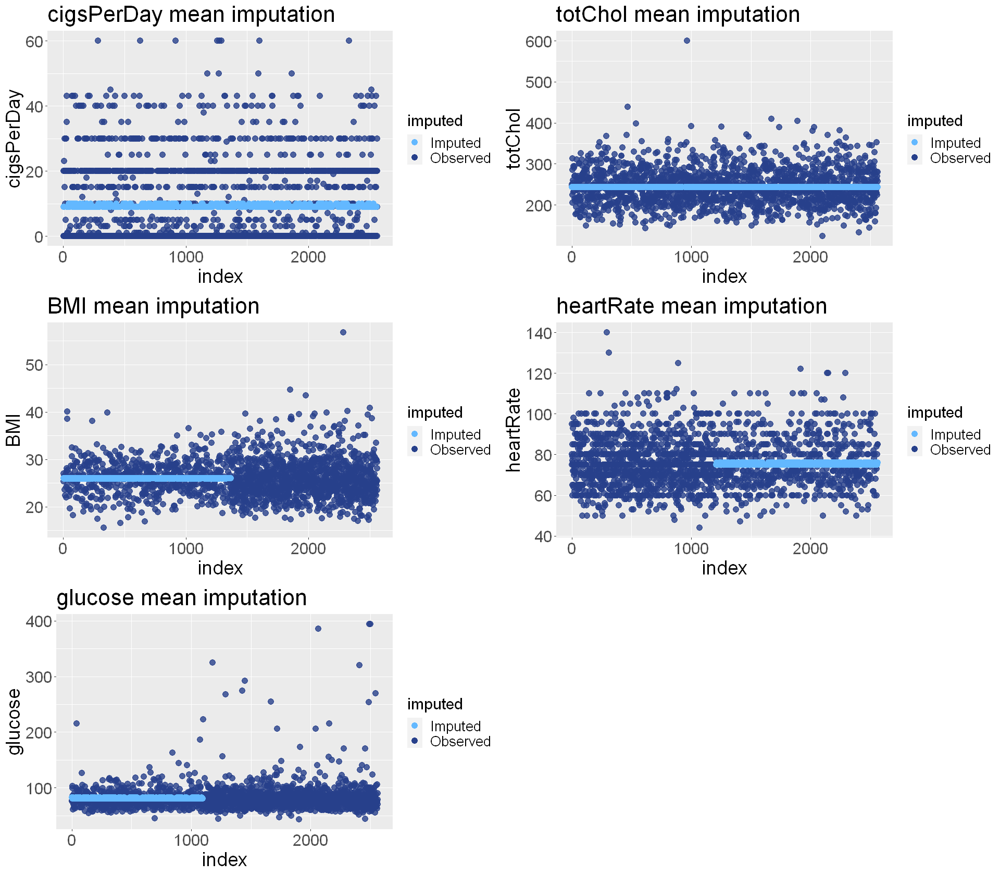

In [258]:
options(repr.plot.width = 16, repr.plot.height = 14)
plt1 <- visImpCont(train1, test1, imp_train1, imp_test1, "cigsPerDay", "mean")
plt2 <- visImpCont(train1, test1, imp_train1, imp_test1, "totChol", "mean")
plt3 <- visImpCont(train1, test1, imp_train1, imp_test1, "BMI", "mean")
plt4 <- visImpCont(train1, test1, imp_train1, imp_test1, "heartRate", "mean")
plt5 <- visImpCont(train1, test1, imp_train1, imp_test1, "glucose", "mean")
plot_grid(plt1, plt2, plt3, plt4, plt5, ncol = 2)

In [19]:
method1_cls <- rep("", ncol(fram_mar))
method1_cls[c(5, 10, 13, 14, 15)] <- "mean"

In [20]:
sim1 <- simulate(fram_mar, "TenYearCHD", 100, method1_cls, 1, 1, "mean.csv", intcols, fcols2)


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: al


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7894072; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6743152; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6743152; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6743152; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4820911; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4820911; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7939486; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6765507; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6765507; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6765507; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7952050; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6715282; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6715282; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7840739; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7754917; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6635401; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6635401; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5897126; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5074130; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5074130; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7889465; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7949154; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6543433; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6543433; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6243433; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5068189; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5068189; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7741351; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6318351; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7791190; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6463521; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6463521; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7853710; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7879674; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6443696; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6443696; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4842701; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4842701; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7671563; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6543674; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6543674; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4813781; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4813781; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4813781; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8008386; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6694761; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6694761; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: al


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7687072; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6521820; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6521820; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6521820; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4903387; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4903387; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7821094; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6476185; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6476185; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5530566; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5080099; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7958397; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7732861; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6448557; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6448557; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6448557; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4945210; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4945210; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7766920; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6483602; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6483602; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5528137; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7669922; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6597182; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6597182; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5953202; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5080090; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5080090; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7787167; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6614444; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6614444; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5607402; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4883870; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7920732; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6631098; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7797812; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6510268; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6510268; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5550394; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5102274; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7799425; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6671702; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6671702; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7754173; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6355083; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7840828; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6603916; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6603916; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5863765; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4959919; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4959919; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7946006; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6692614; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6692614; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6692614; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7837104; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6708899; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6708899; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6708899; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7965050; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6653551; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7657056; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6606980; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7798538; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6743496; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6743496; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6743496; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7832827; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6471125; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6471125; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5313070; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5051672; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7972603; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6480974; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6480974; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6480974; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7948879; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6679898; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6679898; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6679898; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8000000; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6695783; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6695783; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6695783; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7718480; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6528035; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6528035; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6250927; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5093451; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7809440; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6635324; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7872727; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6663636; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6663636; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6663636; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4903030; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4903030; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7908676; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6624049; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, t


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7911188; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6749825; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6749825; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp       


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7776719; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7870411; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6723527; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6723527; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6723527; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5046468; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5046468; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7762195; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6582317; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7981928; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6734940; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6734940; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7851805; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6733990; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6733990; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6733990; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5094914; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5094914; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7820540; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6569344; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6569344; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5430122; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4762420; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7642259


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7654854; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6434320; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6434320; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5195018; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7634094; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6649585; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6649585; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6649585; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5068189; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5068189; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7936628


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7830626; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6598316; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6598316; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6598316; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5094850; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5094850; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7831968; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6582673; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6582673; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5139776; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7990950; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6458522; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7893087; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7723092; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6437893; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6437893; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6089935; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5077078; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7688822; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6589124; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7754545; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6484848; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6484848; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7831370; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6539238; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6539238; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5062147; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5062147; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7778445; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6637558; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6637558; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6285148; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5099321; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5099321; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7967997; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6598142; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6598142; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5636918; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5077160; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7825487; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6520315; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6520315; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6520315; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7651515; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6463636; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6463636; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5578788; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4933333; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7714563; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6474649; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7707831; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6608434; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6500000; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5096386; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7790020; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6498743; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7818920; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6389062; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6389062; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5068257; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5068257; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5068257; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7724546; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6435039; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6435039; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4884807; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4884807; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4884807; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7740983; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6623318; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6623318; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6281928; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5082997; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7784500; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6664773; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6664773; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6258713; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5072631; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7837983; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6744900; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7672750; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6438294; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6438294; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7605951; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, t


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, s

In [21]:
sim1

glm       knn        dt        rf 
0.5521596 0.7538185 0.7781847 0.8142879

##### Linear regression imputation

In [270]:
train2 <- train
method2 <- rep("", ncol(train2))
method2[c(5, 10, 13, 14, 15)] <- "norm.predict"
imp_train2 <- mice(train2, method=method2, m=1, maxit=1, predictorMatrix=predm_train) %>% complete()


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


In [271]:
test2 <- test
imp_test2 <- mice(test2, method=method2, m=1, maxit=1, predictorMatrix=predm_test) %>% complete()


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


In [272]:
imp_train2[intcols] <- imp_train2[intcols] %>% lapply(as.integer)
imp_test2[intcols] <- imp_test2[intcols] %>% lapply(as.integer)

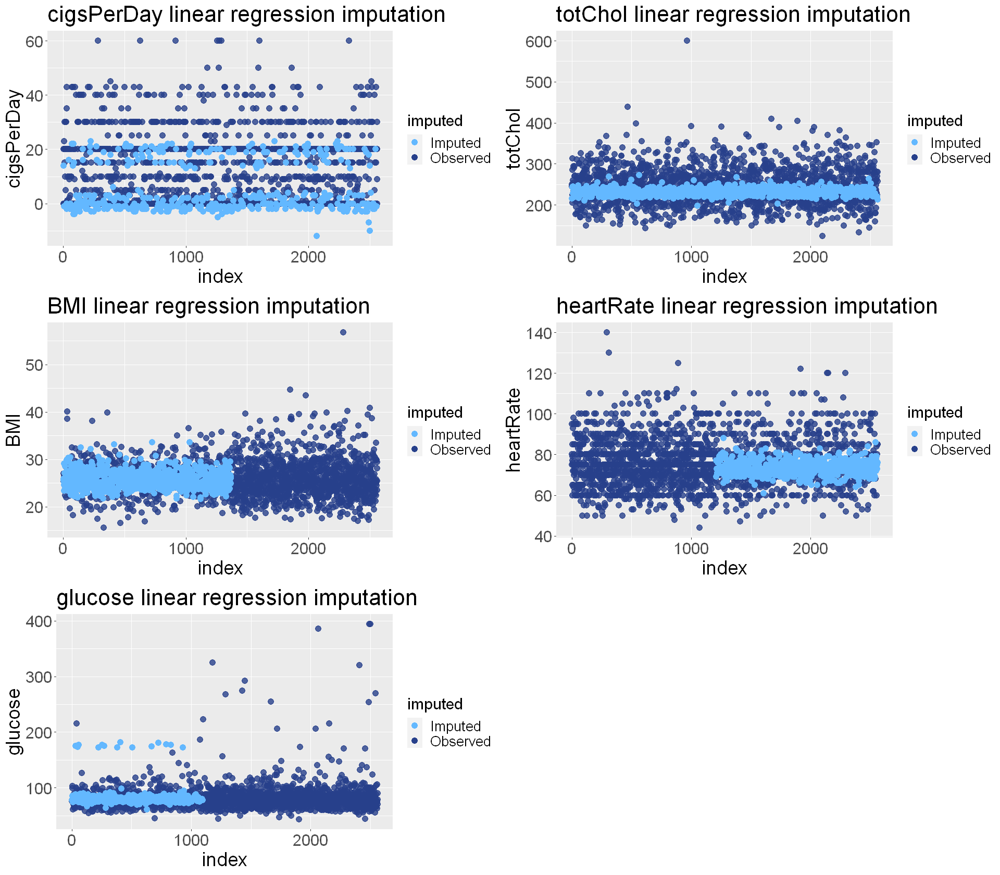

In [273]:
options(repr.plot.width = 16, repr.plot.height = 14)
plt1 <- visImpCont(train2, test2, imp_train2, imp_test2, "cigsPerDay", "linear regression")
plt2 <- visImpCont(train2, test2, imp_train2, imp_test2, "totChol", "linear regression")
plt3 <- visImpCont(train2, test2, imp_train2, imp_test2, "BMI", "linear regression")
plt4 <- visImpCont(train2, test2, imp_train2, imp_test2, "heartRate", "linear regression")
plt5 <- visImpCont(train2, test2, imp_train2, imp_test2, "glucose", "linear regression")
plot_grid(plt1, plt2, plt3, plt4, plt5, ncol = 2)

In [24]:
method2_cls <- rep("", ncol(fram_mar))
method2_cls[c(5, 10, 13, 14, 15)] <- "norm.predict"

In [25]:
sim2 <- simulate(fram_mar, "TenYearCHD", 100, method2_cls, 1, 1, "linreg.csv", intcols, fcols2)


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7968235; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7942073; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6420732; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7872550; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6391348; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6391348; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4922268; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4922268; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4922268; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8078677; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6749046; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7842949


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8121646; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6636397; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6636397; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6285414; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5075620; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7713855; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6424699; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6424699; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5096386; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7956155; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6583450; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6583450; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5577425; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5099230; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 3"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8129221; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6626458; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6626458; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6279550; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5087522; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8007321; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6605153; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6605153; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5920304; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5069614; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5069614; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7702657; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6350488; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6350488; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7919140; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6741170; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6741170; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6741170; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7830560; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6599092; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7854172; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6546117; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6546117; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5093492; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5093492; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8008006; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6702299; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7683706; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7992803; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6635565; time: 0.0 min

[Tune-x] 3: cp=0.21; mi


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7760094; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6536354; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6536354; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5586484; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5105281; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5105281; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, t


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7794836; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6640309; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7923775; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6492220; time: 0.0 min

[Tune-x] 3: cp=0.21; mi


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7811414; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6617634; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6617634; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6617634; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4759698; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4759698; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7960117; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6684900; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6684900; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8022434; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6533028; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6533028; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6228352; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5091965; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5091965; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7796198; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6481814; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7907196; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7875608; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6485800; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7775470


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8074655; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6674740; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6674740; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6674740; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7929309


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7667753; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6572026; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6572026; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6190346; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4832084; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4832084; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7699195; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6493749; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6493749; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4943553; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7624146; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6326411; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6326411; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5097939; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7887023; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6577099; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7910465; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6479221; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6479221; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5564935; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5105110; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5105110; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7821244; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6563670; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6563670; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7848485; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6457576; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6457576; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5787879; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7819396; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7790326; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6540734; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6540734; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5482807; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4946616; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4946616; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7822973; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6500414; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7885023; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6523449; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6523449; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5074130; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8066768; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6585736; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7949843; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6503652; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6503652; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5890359; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7994485; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6705827; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6705827; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6705827; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7953792; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6439684; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6439684; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4879905; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7952284; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6677839; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7981679; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6589313; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6589313; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7674699; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7827503; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6448378; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7789212; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6708213; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6708213; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7871756; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7657787


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 3"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7947580; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6590379; time: 0.0 min

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 3"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8132433; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6718806; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6718806; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7810107; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6401225; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6401225; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5148545; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7955716; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6477104; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6477104; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7816493; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6424987; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6424987; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7973192; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6415725; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6415725; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4745522; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7948250


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7832737; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6431030; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8000585; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6443173; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6443173; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4824753; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4824753; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4824753; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8001755; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6577996; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6577996; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5796316; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7960305; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6586260; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7773807; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6401966; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6401966; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5102278; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5102278; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5102278; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7887960; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6461647; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6461647; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5442268; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4869916; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8084048; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7946201; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6705418; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6705418; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6705418; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7923022; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6504953; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6504953; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6178733; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4949707; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4949707; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7543564; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6324495; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6324495; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5099330; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5099330; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5099330; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7876951; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6390217; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6390217; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5286544; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5090466; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5090466; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7776474; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6500260; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6390550; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4928426; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7899390; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6762195; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6762195; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6762195; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4908537; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7865767; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6598505; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6598505; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5616578; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5099284; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5099284; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7960426; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6605784; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6605784; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6240487; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4943683; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7939805; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6614969; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6614969; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7835195; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6355611; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6355611; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4858211; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7872445; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6419475; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6419475; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5537363; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7870662; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6512852; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6512852; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5054610; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5054610; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5054610; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

   


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7940291; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6611900; time: 0.0 min

[Tun

In [26]:
sim2

glm       knn        dt        rf 
0.5373239 0.7510798 0.7520970 0.8109390

##### 3. Stochastic regression imputation

In [285]:
train3 <- train
method3 <- rep("", ncol(train3))
method3[c(5, 10, 13, 14, 15)] <- "norm.nob"
imp_train3 <- mice(train3, method=method3, m=1, maxit=1, predictorMatrix=predm_train) %>% complete()


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


In [286]:
test3 <- test
imp_test3 <- mice(test3, method=method3, m=1, maxit=1, predictorMatrix=predm_test) %>% complete()


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


In [287]:
imp_train3[intcols] <- imp_train3[intcols] %>% lapply(as.integer)
imp_test3[intcols] <- imp_test3[intcols] %>% lapply(as.integer)

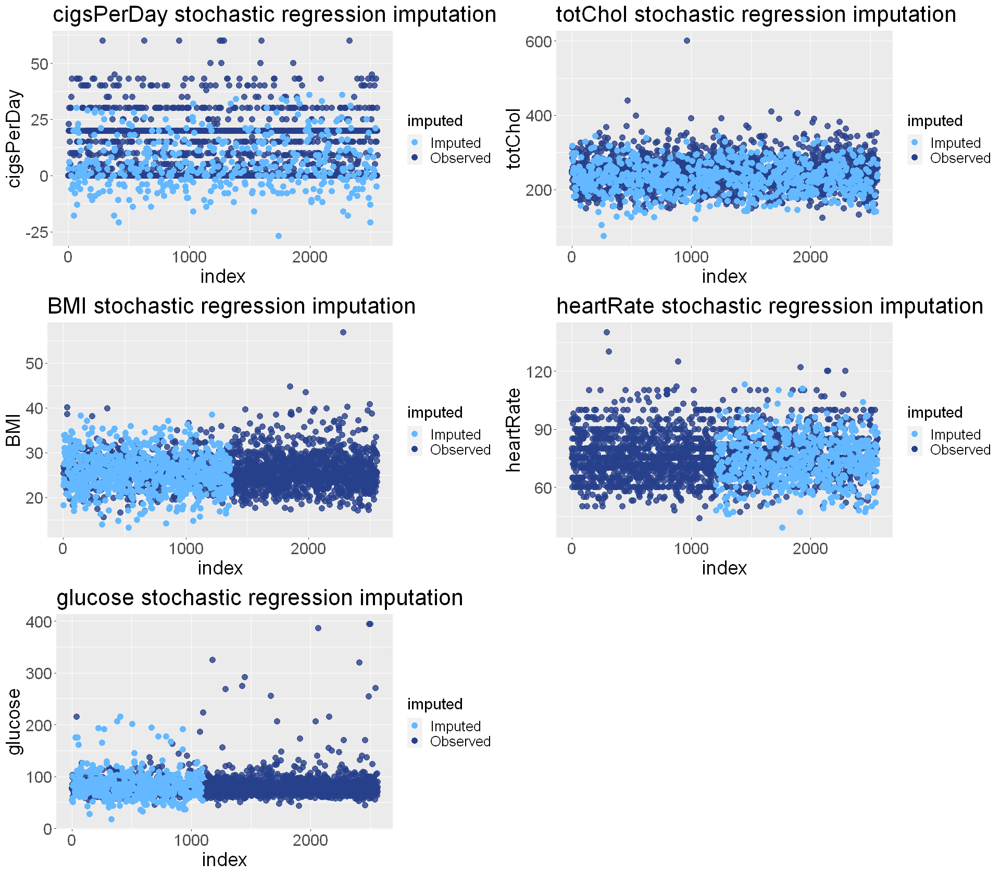

In [288]:
options(repr.plot.width = 16, repr.plot.height = 14)
plt1 <- visImpCont(train3, test3, imp_train3, imp_test3, "cigsPerDay", "stochastic regression")
plt2 <- visImpCont(train3, test3, imp_train3, imp_test3, "totChol", "stochastic regression")
plt3 <- visImpCont(train3, test3, imp_train3, imp_test3, "BMI", "stochastic regression")
plt4 <- visImpCont(train3, test3, imp_train3, imp_test3, "heartRate", "stochastic regression")
plt5 <- visImpCont(train3, test3, imp_train3, imp_test3, "glucose", "stochastic regression")
plot_grid(plt1, plt2, plt3, plt4, plt5, ncol = 2)

In [27]:
method3_cls <- rep("", ncol(fram_mar))
method3_cls[c(5, 10, 13, 14, 15)] <- "norm.nob"

In [28]:
sim3 <- simulate(fram_mar, "TenYearCHD", 100, method3_cls, 1, 1, "stochreg.csv", intcols, fcols2)


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7750697; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6568616; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6568616; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5192859; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 3"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y]


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7603053; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7851966; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6410957; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6410957; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5102242; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5102242; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5102242; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7718304; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6737654; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7811550; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6434650; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6434650; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7911328; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6530047; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6530047; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5859334; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4927236; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4927236; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7777108; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6334337; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6334337; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7787281; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6508458; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6508458; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5078532; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5078532; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7945303; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6657641; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6657641; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6657641; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5102260; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5102260; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7875059; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6292753; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6180632; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4907573; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4907573; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4907573; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7803561; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6711367; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6711367; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7835328; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6351818; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6351818; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4922757; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7784914; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6566447; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6551250; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4816158; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7824285; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6542016; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7951662; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6444109; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6444109; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5540785; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5081571; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5081571; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7908040; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6397710; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6397710; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4948222; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4948222; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4948222; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7569044; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6643399; time: 0.0 min

[Tune-x] 3: cp=0.21; mi


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7789584; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6421410; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8025521; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6322729; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6322729; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4845792; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4845792; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4845792; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7687359; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6537184; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6537184; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7975175; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6549640; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6549640; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6192605; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5072645; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5072645; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7712379; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6171187; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6171187; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4924187; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4924187; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4924187; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7740086; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6480721; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8017550; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6657513; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6657513; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6657513; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7754710; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6402579; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6402579; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7686944; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6460785; time: 0.0 min

[Tune-x] 3: cp=0.21; mi


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7986695; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6429858; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6429858; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5078582; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5078582; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7767746; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6531303; time: 0.0 min

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7733582; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6692905; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 3"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7843801; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6649571; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6649571; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6299647; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5090461; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7755230


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7693451; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6285787; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6285787; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4954296; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7890744; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6476480; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6476480; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5256449; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5059181; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5059181; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7808890; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6561283; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6387767; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4747406; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4747406; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4747406; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7919750; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7883096; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6519123; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7723963; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7859556; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6448532; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6448532; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5815575; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4895919; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4895919; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7869697; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6615152; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6615152; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6275758; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7772338; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6478967; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6478967; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5563094; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5037209; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 3"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7830585; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6703888; time: 0.0 min

[Tune-x] 3: cp=0.21; mi


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7712337; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6562468; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6562468; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5849777; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5060703; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5060703; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7861411; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6612205; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7967895; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6450690; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6450690; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7744866; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6599042; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6599042; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5904178; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4915394; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4915394; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7742604; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6595889; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6595889; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6219561; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7839103; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6621550; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7972032; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6741791; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6741791; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6741791; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7845291; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6727146; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6727146; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7893670; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6446042; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6446042; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5080081; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5080081; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8152383; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6664630; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6664630; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6664630; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5077000; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5077000; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7762956; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6562657; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6562657; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5407431; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8034886; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6732936; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6732936; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6732936; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5093501; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5093501; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7935258; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6602173; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6602173; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5595591; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5078596; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5078596; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 3"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y]


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7734971; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7834944; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6534743; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6534743; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4722955; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4722955; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8053809; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6681641; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6681641; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6291913; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4910796; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 3"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8001172; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6777267; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6777267; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6777267; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5092006; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7905274; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6420249; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6420249; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5086028; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7941054; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6547237; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7787130; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6458218; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6458218; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5105223; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5105223; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7927848; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6686899; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6686899; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6686899; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7674722; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6444021; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6444021; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4962958; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4962958; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7926229; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6749041; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6749041; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6749041; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4839941; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4839941; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7790774; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6405098; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6405098; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5106640; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5106640; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5106640; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7775477; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6373480; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6373480; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5112561; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5112561; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7951880; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6463158; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6463158; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7747351; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6599942; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6599942; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5931747; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5057695; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5057695; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7865297; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6603195; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6603195; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5579504; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5084455; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5084455; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7692542; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6703196; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6703196; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6703196; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7826967; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6650462; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7881403; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6626267; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6626267; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6256701; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5057499; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5057499; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7778452; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6291351; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6291351; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5059181; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5059181; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep

In [29]:
sim3

glm       knn        dt        rf 
0.5686072 0.7535994 0.7779656 0.8182473

##### Predictive mean matching

In [300]:
train4 <- train
method4 <- rep("", ncol(train4))
method4[c(5, 10, 13, 14, 15)] <- "pmm"
imp_train4 <- mice(train4, method=method4, m=1, maxit=1, predictorMatrix=predm_train) %>% complete()


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


In [301]:
test4 <- test
imp_test4 <- mice(test4, method=method4, m=1, maxit=1, predictorMatrix=predm_test) %>% complete()


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


In [302]:
imp_train4[intcols] <- imp_train4[intcols] %>% lapply(as.integer)
imp_test4[intcols] <- imp_test4[intcols] %>% lapply(as.integer)

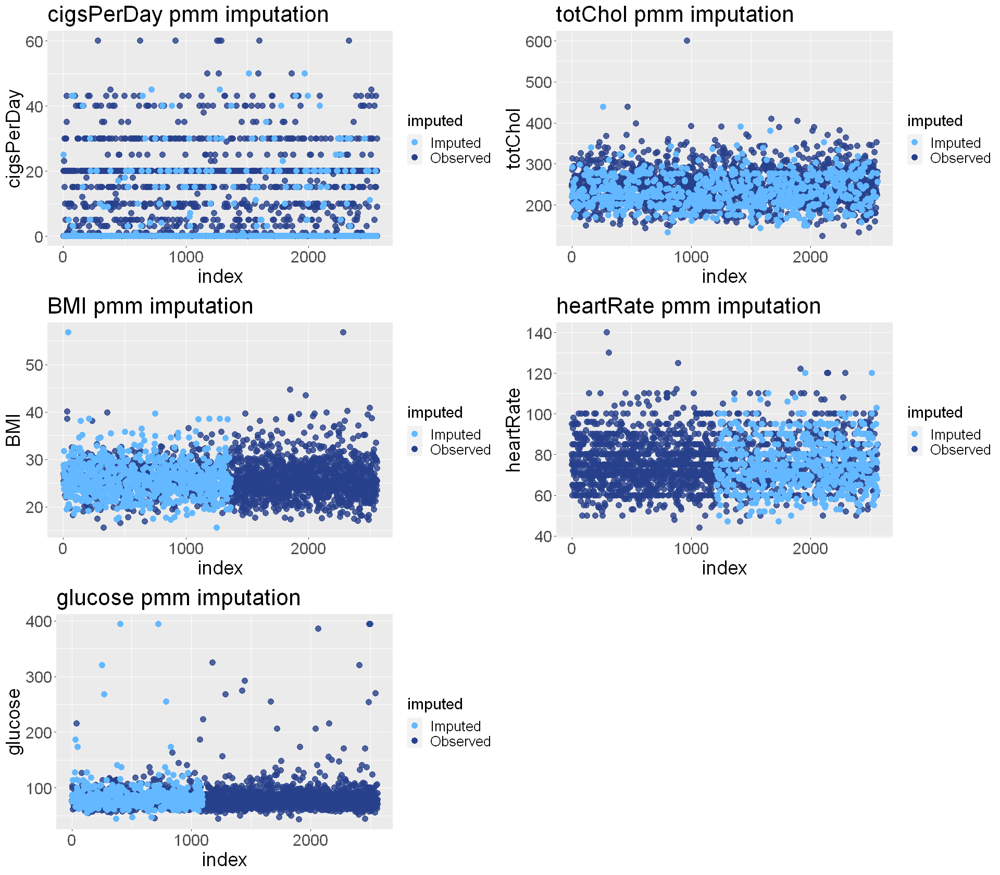

In [303]:
options(repr.plot.width = 16, repr.plot.height = 14)
plt1 <- visImpCont(train4, test4, imp_train4, imp_test4, "cigsPerDay", "pmm")
plt2 <- visImpCont(train4, test4, imp_train4, imp_test4, "totChol", "pmm")
plt3 <- visImpCont(train4, test4, imp_train4, imp_test4, "BMI", "pmm")
plt4 <- visImpCont(train4, test4, imp_train4, imp_test4, "heartRate", "pmm")
plt5 <- visImpCont(train4, test4, imp_train4, imp_test4, "glucose", "pmm")
plot_grid(plt1, plt2, plt3, plt4, plt5, ncol = 2)

In [30]:
method4_cls <- rep("", ncol(fram_mar))
method4_cls[c(5, 10, 13, 14, 15)] <- "pmm"

In [31]:
sim4 <- simulate(fram_mar, "TenYearCHD", 100, method4_cls, 1, 1, "pmm.csv", intcols, fcols2)


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7720162; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6399449; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6241634; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5057649; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5057649; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8000000; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6695518; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6695518; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7838535; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6505460; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6505460; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: al


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7807711; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6592081; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6592081; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5594558; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, t


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7874112; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6651427; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6651427; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6186382; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4890568; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7921326; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6528497; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6528497; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6193642; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4952788; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4952788; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7867104; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6571596; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7560902; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6294737; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, t


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7878712; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6593170; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6593170; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5564513; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5087454; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5087454; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7771084; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6463855; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6463855; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5512048; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5096386; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7968450; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6663595; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6663595; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8061579; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6632109; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6632109; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6257109; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5038080; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5038080; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7946216; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6590149; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7932333


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7943213; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6381451; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6381451; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7918465; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6615897; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7775076; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6404255; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6404255; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5051672; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7738998; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6282246; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6133536; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7866907; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6681884; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6681884; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6681884; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5053129; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5053129; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8069029; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6581472; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6581472; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5386370; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4789010; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7893778; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6491654; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6491654; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5896813; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5059181; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7939935


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7949363; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6709303; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6709303; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 3"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7957831; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6695783; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6695783; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6695783; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5096386; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8121893; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6620164; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6620164; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6620164; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7718213; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6419254; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7955333; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6567902; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6567902; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5170829; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4871592; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7945701; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6648567; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6648567; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6262443; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5088989; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5088989; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7912782; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6406015; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6406015; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5314286; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7655589; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6383686; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6383686; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5081571; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5081571; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7967979; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6579035; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6579035; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5326216; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5084524; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5084524; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7920732; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6515244; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6515244; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6231707; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4957317; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7955514; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6544045; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7949578; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6688913; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6688913; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6688913; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4851262; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4851262; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7887123; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6663698; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6663698; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6275231; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7878821; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6529836; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6529836; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6173878; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5087513; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5087513; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7923482; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6630176; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6630176; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6630176; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7707628; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6478399; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6478399; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4829303; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7737329; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7728090; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6585830; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6585830; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5596163; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5052684; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5052684; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7852790; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6556764; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7716366; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6380234; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6380234; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5056127; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5056127; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7712300; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6325527; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6325527; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7735964; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6309560; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7482561; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6448775; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7981873; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6622356; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7809222; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6502070; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6502070; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7674699; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6376506; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6376506; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5096386; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5096386; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5096386; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7839637; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6695915; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6695915; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6695915; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5074130; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7817937; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6398408; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6398408; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5093419; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5093419; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7762712; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6425270; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6425270; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5072419; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4816641; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4816641; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7774777; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6548567; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6548567; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4925806; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4925806; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7984225; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6642208; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6642208; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6642208; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7969260; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6581204; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7851241; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6430973; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6430973; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5480227; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7907694; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6644455; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6644455; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6644455; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5056243; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5056243; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7859947


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7771714; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6675639; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6675639; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6675639; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5084524; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5084524; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: dopasowane prawdopodo


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7809113; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6605440; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6605440; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5549298; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5100874; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5100874; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7792284; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6638450; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6638450; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6263260; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7828066


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7883290; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6682761; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7854950; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6583772; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6583772; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5303044; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5060620; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7913109; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6567522; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6567522; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7871184; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6639560; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8030958; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6593771; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6593771; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5934196; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7812809; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6613139; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6467684; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7795803; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6462880; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6462880; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5799272; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7705087; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6556070; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6556070; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5090484; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5090484; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5090484; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7883116; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6483881; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6483881; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5802572; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5069665; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5069665; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7846766; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6620103; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6580768; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5433466; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4927406; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8048120; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6400000; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7978756; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6628225; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6628225; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6264036; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4934750; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4934750; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7879485; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6670747; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6670747; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6670747; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7860291; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6494385; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6494385; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5080113; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5080113; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7844038; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7894459; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6586863; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6586863; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6586863; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5060703; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5060703; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm

In [32]:
sim4

glm       knn        dt        rf 
0.5741315 0.7523787 0.7789671 0.8206573

##### MICE with linear regression

In [315]:
train5 <- train
method5 <- rep("", ncol(train5))
method5[c(5, 10, 13, 14, 15)] <- "norm.predict"
imp_train5 <- mice(train5, method=method5, m=25, maxit=50, predictorMatrix=predm_train, printFlag = FALSE) %>% complete(action="long")
imp_train5 <- subset(imp_train5, select = -.id)

In [316]:
test5 <- test
imp_test5 <- mice(test5, method=method5, m=25, maxit=50, predictorMatrix=predm_test, printFlag = FALSE) %>% complete(action="long")
imp_test5 <- subset(imp_test5, select = -.id)

In [317]:
imp_train5[intcols] <- imp_train5[intcols] %>% lapply(as.integer)
imp_test5[intcols] <- imp_test5[intcols] %>% lapply(as.integer)

In [318]:
orgtest <- rbind(test5, test5, test5, test5)
orgtrain <- rbind(train5, train5, train5, train5)
imptest <- subset(imp_test5, .imp <= 4)
imptrain <- subset(imp_train5, .imp <= 4)

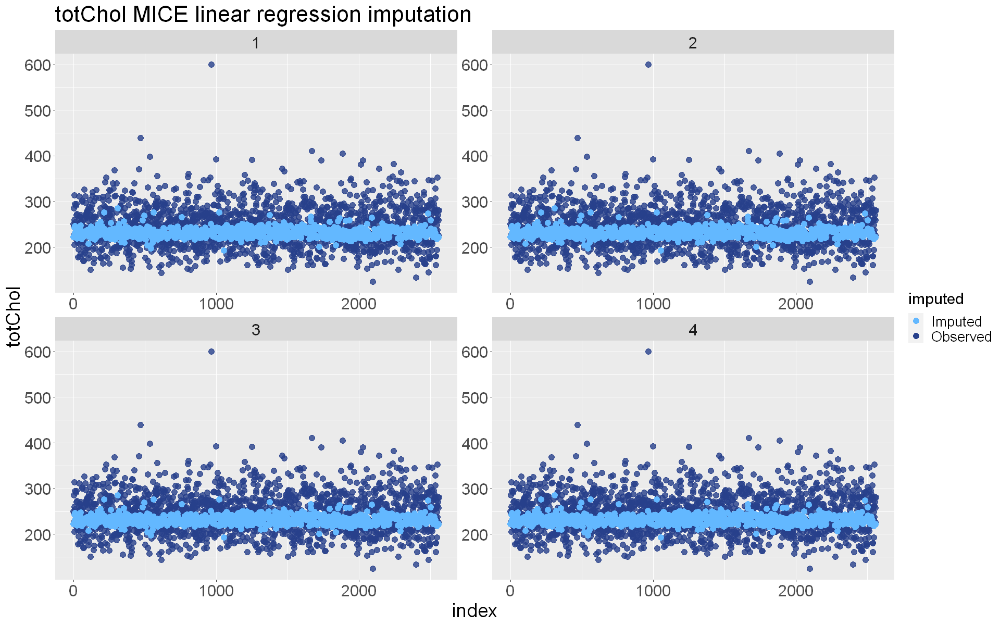

In [319]:
options(repr.plot.width = 16, repr.plot.height = 10)
visImpMul(orgtrain, orgtest, imptrain, imptest, "totChol", "MICE linear regression")

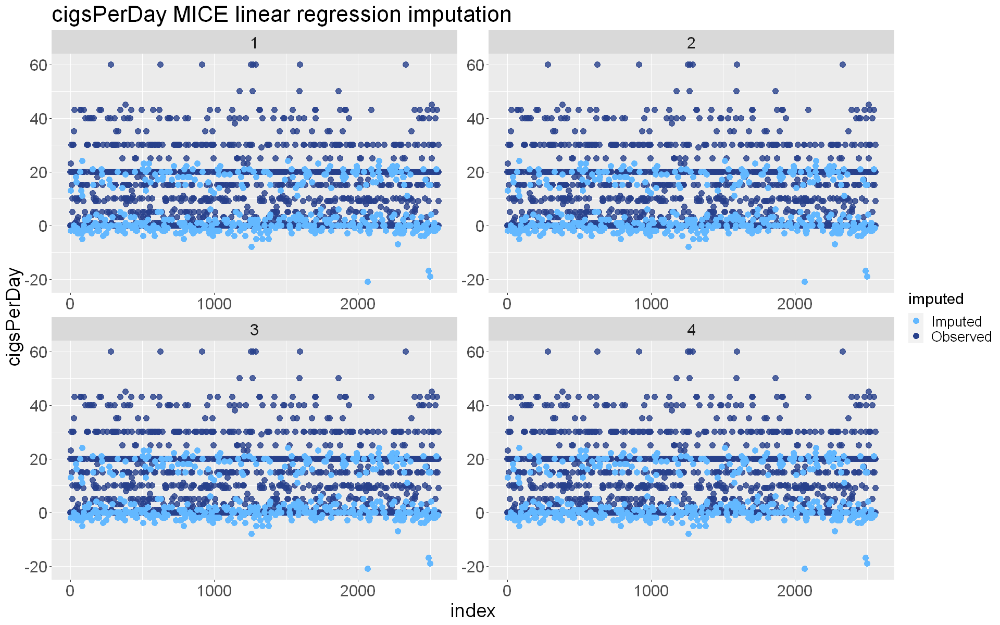

In [320]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "cigsPerDay", "MICE linear regression")

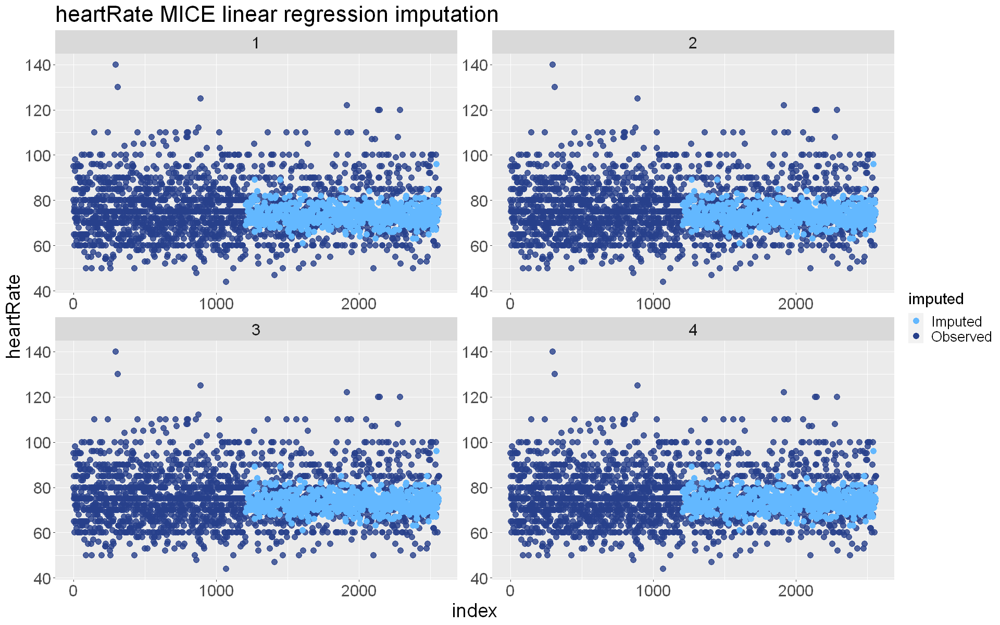

In [321]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "heartRate", "MICE linear regression")

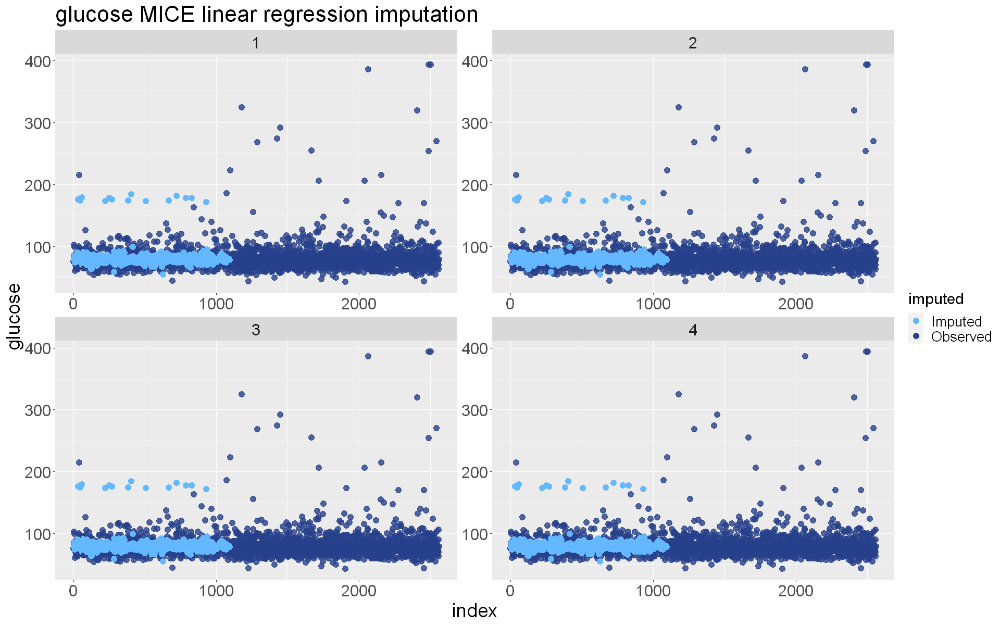

In [322]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "glucose", "MICE linear regression")

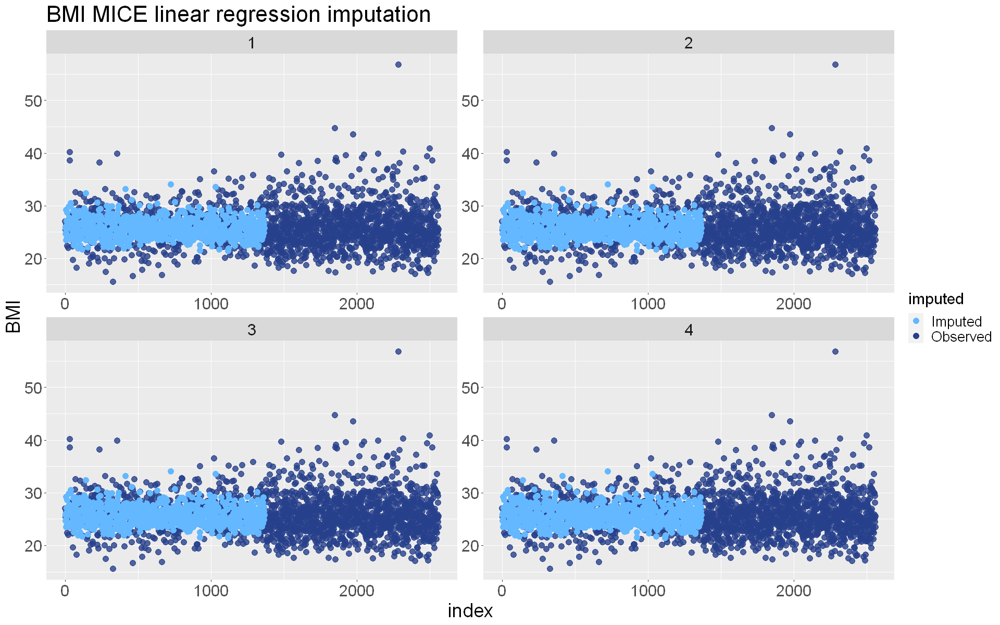

In [323]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "BMI", "MICE linear regression")

In [18]:
method5_cls <- rep("", ncol(fram_mar))
method5_cls[c(5, 10, 13, 14, 15)] <- "norm.predict"

In [ ]:
sim5 <- simulate(fram_mar, "TenYearCHD", 100, method5_cls, 5, 5, "mul_linreg.csv", intcols, fcols2)

In [39]:
sim5

glm       knn        dt        rf 
0.5843349 0.7544757 0.8042097 0.8213459

##### MICE with stochastic regression

In [339]:
train6 <- train
method6 <- rep("", ncol(train6))
method6[c(5, 10, 13, 14, 15)] <- "norm.nob"
imp_train6 <- mice(train6, method=method6, m=25, maxit=50, predictorMatrix=predm_train, printFlag = FALSE) %>% complete(action="long")
imp_train6 <- subset(imp_train6, select = -.id)

In [340]:
test6 <- test
imp_test6 <- mice(test6, method=method6, m=25, maxit=50, predictorMatrix=predm_test, printFlag = FALSE) %>% complete(action="long")
imp_test6 <- subset(imp_test6, select = -.id)

In [341]:
imp_train6[intcols] <- imp_train6[intcols] %>% lapply(as.integer)
imp_test6[intcols] <- imp_test6[intcols] %>% lapply(as.integer)

In [342]:
orgtest <- rbind(test6, test6, test6, test6)
orgtrain <- rbind(train6, train6, train6, train6)
imptest <- subset(imp_test6, .imp <= 4)
imptrain <- subset(imp_train6, .imp <= 4)

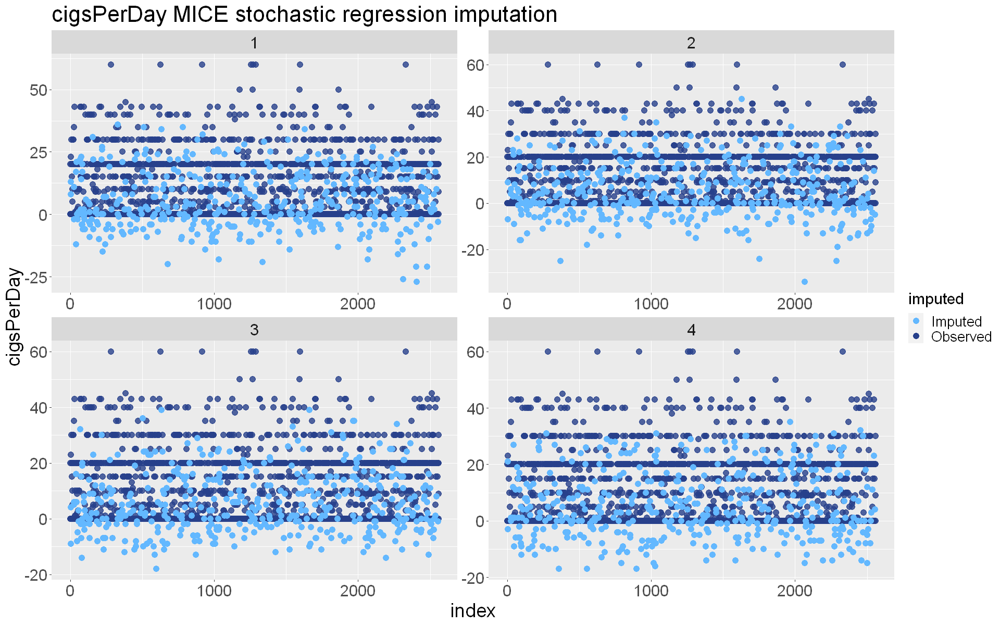

In [343]:
options(repr.plot.width = 16, repr.plot.height = 10)
visImpMul(orgtrain, orgtest, imptrain, imptest, "cigsPerDay", "MICE stochastic regression")

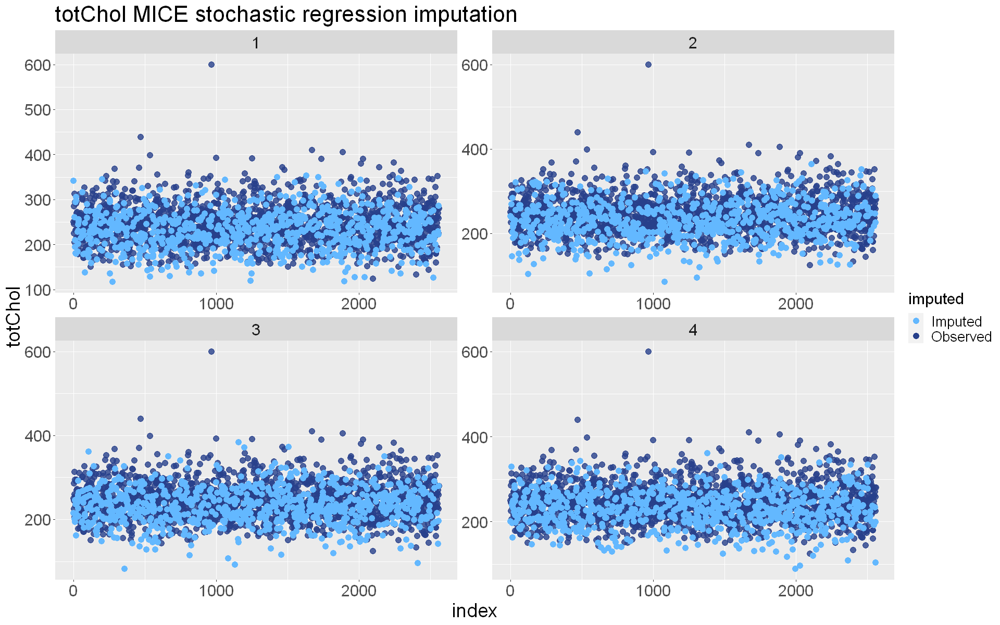

In [344]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "totChol", "MICE stochastic regression")

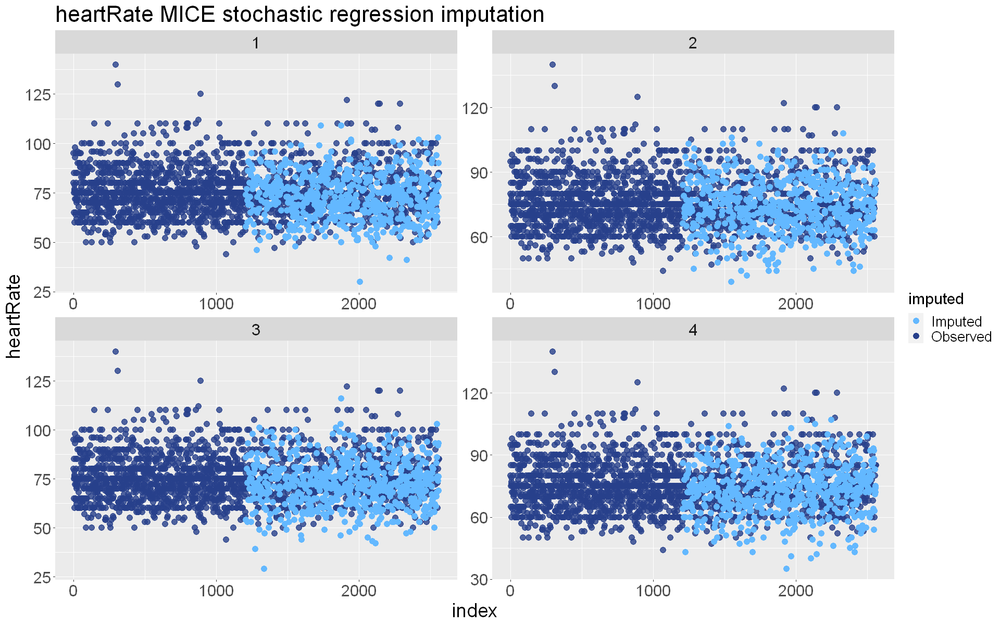

In [345]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "heartRate", "MICE stochastic regression")

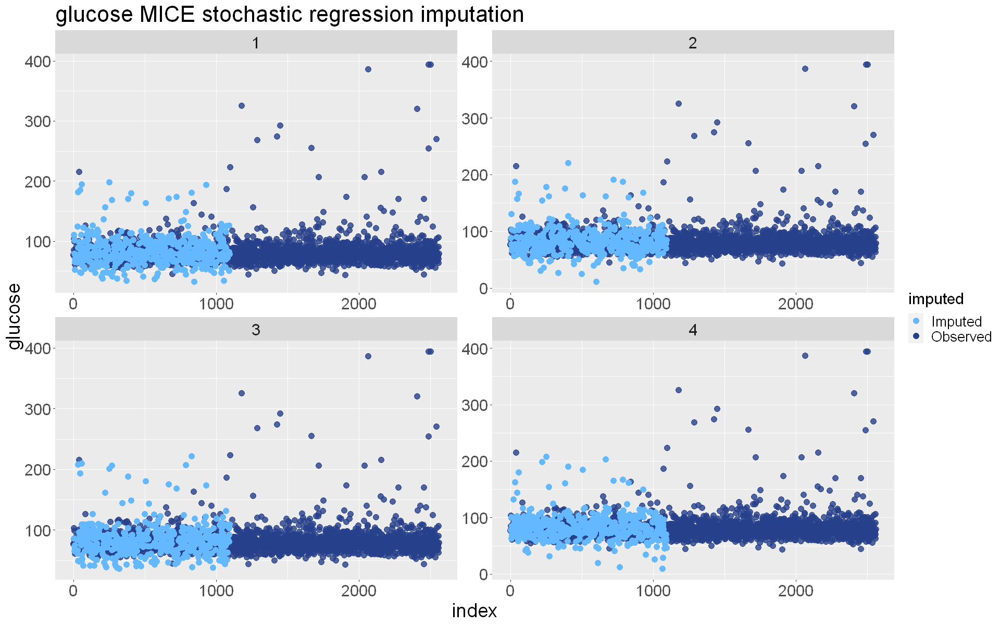

In [346]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "glucose", "MICE stochastic regression")

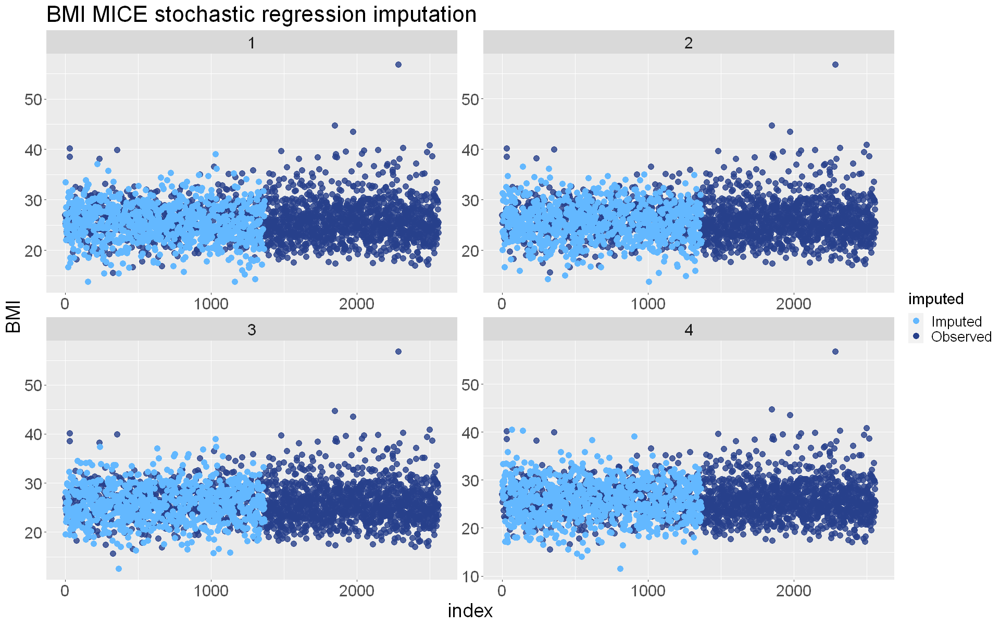

In [347]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "BMI", "MICE stochastic regression")

In [20]:
method6_cls <- rep("", ncol(fram_mar))
method6_cls[c(5, 10, 13, 14, 15)] <- "norm.nob"

In [21]:
sim6 <- simulate(fram_mar, "TenYearCHD", 100, method6_cls, 5, 5, "stochreg_mul.csv", intcols, fcols2)


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 50"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1996850; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3458268; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3458268; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 75"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2128312; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3343625; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3343625; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3343625; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5123390; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1914912; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3242229; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1761905; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3498413; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3498413; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.4380952; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 50"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2200347; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3259336; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3259336; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1915094; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3091195; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3091195; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3091195; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2134269


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1884897; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3401176; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2185149; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3247451; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3247451; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

   


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2049383; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3200617; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3200617; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3200617; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5179012; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.5179012


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 50"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2173527; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3157579; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3157579; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3157579; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5141039; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 1"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2091678; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3199619; time: 0.0 min

[Tune-x] 3: cp=0.21; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1997398; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3215573; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3215573; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1955696; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3174051; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3174051; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3174051; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4848101; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.4848101


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 50"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1957409; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3335337; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3335337; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3335337; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4818664; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, t


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2027468


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1920997


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 50"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2098613; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3164869; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3164869; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3164869; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5155624; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2122593; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3404148; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3404148; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3820173; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2070744; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3176190; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3176190; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3176190; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4813671; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2132213; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3396871; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3396871; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3803866; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2012251; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3228178; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3228178; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3228178; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5111792; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.5111792


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1996914; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3206790; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3206790; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3206790; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5080247; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.5080247


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2157397; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3244187; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3326989; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3998964; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 50"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2069952; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3389507; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3468998; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3780604; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4823529; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, t


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2018433; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3314900; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3314900; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3314900; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2084732; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3437339; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3437339; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3437339; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4818659; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2000633; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3335540; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3335540; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3335540; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5348309; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2137640; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3330174; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3330174; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3977275; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1882166; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3394904; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3394904; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3687898; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1851548; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3116645; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tu


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 50"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1969001; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3295332; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3295332; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3703560; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4846516; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1877625


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1916794; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3375754; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3375754; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3699563; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4825160; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; ma


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2036810; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3377301; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3377301; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3377301; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2049873


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1887884; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3360081; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3360081; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3360081; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5161659; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; ma


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2030943; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3291153; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3291153; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1960699; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3031499; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3031499; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3031499; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2052976; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3419500; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3419500; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3419500; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5161636; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.5161636


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1927330; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3017378; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3017378; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3017378; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4856240; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1953387; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3295000; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tu


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1893765; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3190540; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1967618; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.2975173; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.2975173; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1839544; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3415853; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3415853; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3767675; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4836717; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1900164; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3303342; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3303342; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2019100; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2118148; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3449167; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3540939; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.4438769; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4853026; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.4853026


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1938596; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3134546; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tu


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1939778; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3305864; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2112640; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3137034; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3137034; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3137034; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1984781; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3199084; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tu


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1989481; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3299287; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3299287; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3299287; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5044770; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.5044770


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2140120; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3300506; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3300506; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.4020562; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4838312; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.4838312


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2064283; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3220797; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3220797; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3220797; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4813636; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.4813636


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 50"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1975997; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3212880; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3212880; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2146264; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3408585; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3424483; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3726550; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 75"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2069432; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3259492; time: 0.0 min

[Tune-x] 3: cp=0.21; 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1904459; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3149682; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tu


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1916409; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3154799; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3154799; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3154799; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5077399; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.5077399


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1985091; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3211453; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tu


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1836167; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3307573; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3307573; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3307573; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5112828; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.5112828


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2038855


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2086227; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3424209; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3424209; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3776032; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4838226; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1795357


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, t


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2056006; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3261485; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tu


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1982136; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3105630; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3105630; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3105630; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1897502


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 50"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1959475; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3085237; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3085237; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1749916; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3270721; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3270721; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3270721; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2020369; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1871577; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3171671; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3171671; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3171671; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5080333; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 50"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1912246; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3417172; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3417172; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3789191; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4820142; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1950403; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3147995; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3147995; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3147995; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4828526; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1994289; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3104270; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3104270; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3104270; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4821879; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1980216; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3271645; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3271645; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3271645; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4808633; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; ma


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2038217; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3079618; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3079618; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 25"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1912039; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3345965; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3406187; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1980231; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3153168; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3153168; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3153168; time: 0.0 min

[Tune-x] 5: cp=0


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2023892; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3380555; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3380555; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3380555; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.5152268; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.5152268


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2088935; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3452691; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3452691; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3452691; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4976888; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.4976888


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

Warning message:
"Number of logged events: 75"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1816489; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3343973; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3343973; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.

In [22]:
sim6

glm       knn        dt        rf 
0.5967762 0.7610485 0.8149922 0.8313302

##### MICE with pmm

In [363]:
train7 <- train
method7 <- rep("", ncol(train7))
method7[c(5, 10, 13, 14, 15)] <- "pmm"
imp_train7 <- mice(train7, method=method7, m=25, maxit=50, predictorMatrix=predm_train, printFlag = FALSE) %>% complete(action="long")
imp_train7 <- subset(imp_train7, select = -.id)

In [364]:
test7 <- test
imp_test7 <- mice(test7, method=method7, m=25, maxit=50, predictorMatrix=predm_test, printFlag = FALSE) %>% complete(action="long")
imp_test7 <- subset(imp_test7, select = -.id)

In [365]:
imp_train7[intcols] <- imp_train7[intcols] %>% lapply(as.integer)
imp_test7[intcols] <- imp_test7[intcols] %>% lapply(as.integer)

In [366]:
orgtest <- rbind(test7, test7, test7, test7)
orgtrain <- rbind(train7, train7, train7, train7)
imptest <- subset(imp_test7, .imp <= 4)
imptrain <- subset(imp_train7, .imp <= 4)

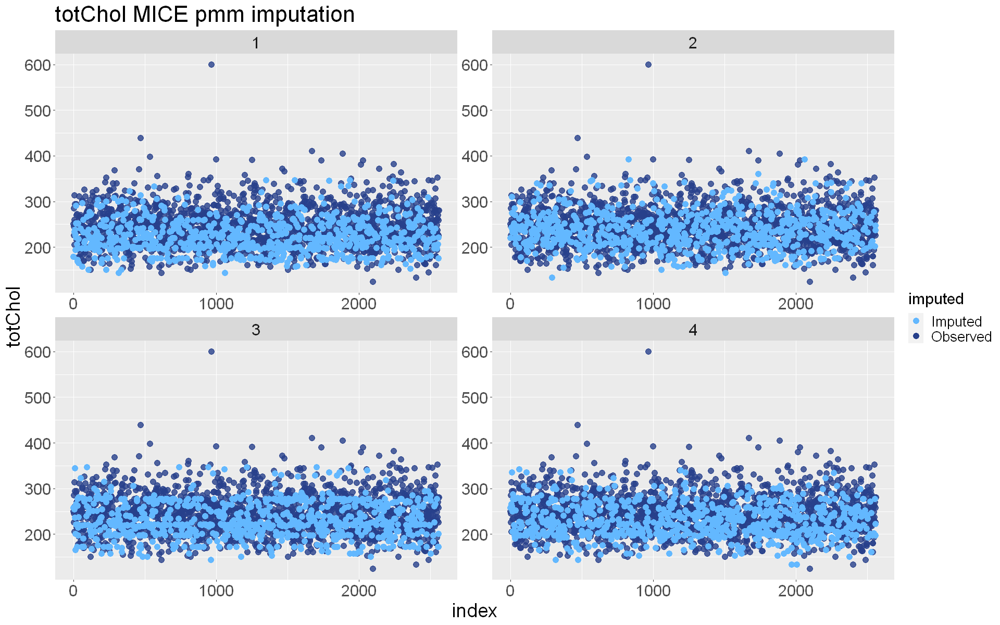

In [367]:
options(repr.plot.width = 16, repr.plot.height = 10)
visImpMul(orgtrain, orgtest, imptrain, imptest, "totChol", "MICE pmm")

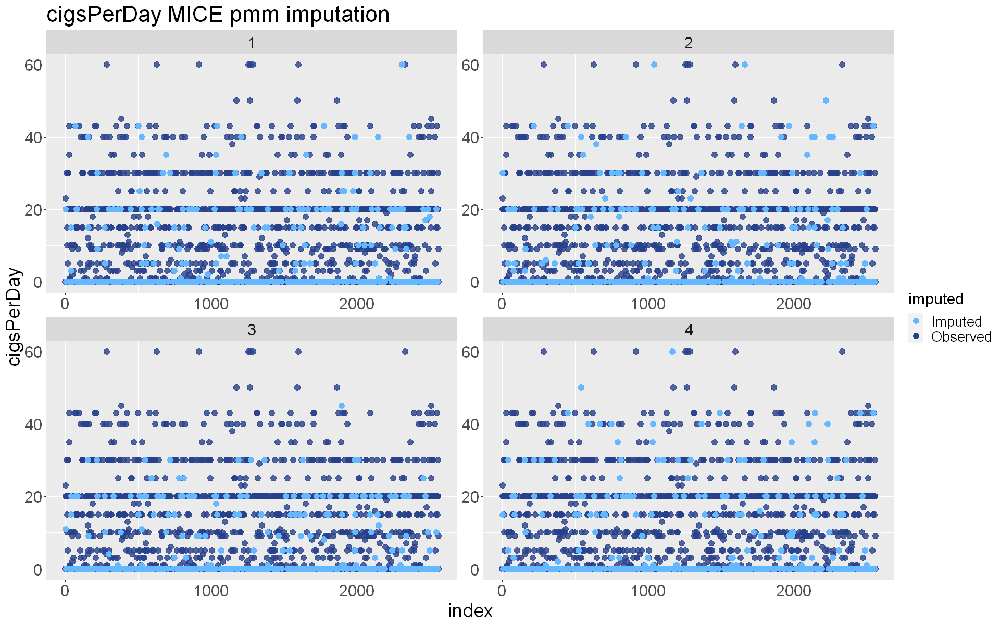

In [368]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "cigsPerDay", "MICE pmm")

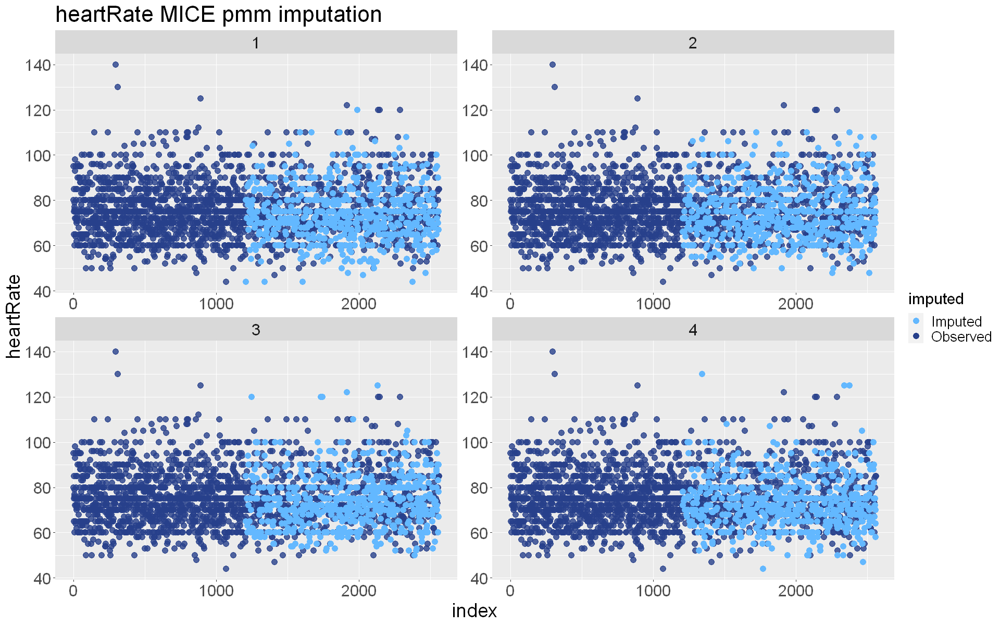

In [369]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "heartRate", "MICE pmm")

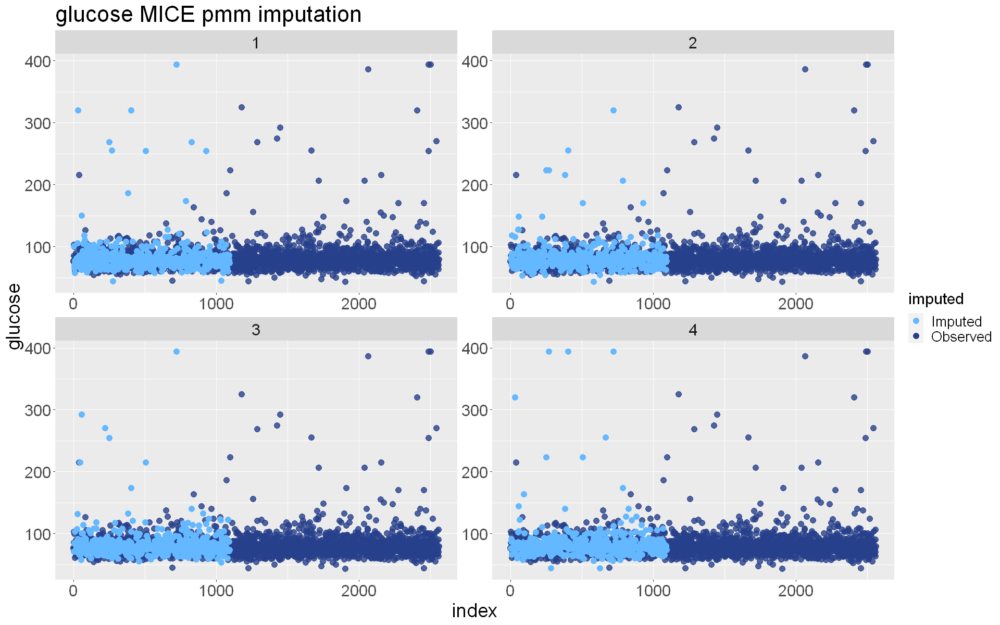

In [370]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "glucose", "MICE pmm")

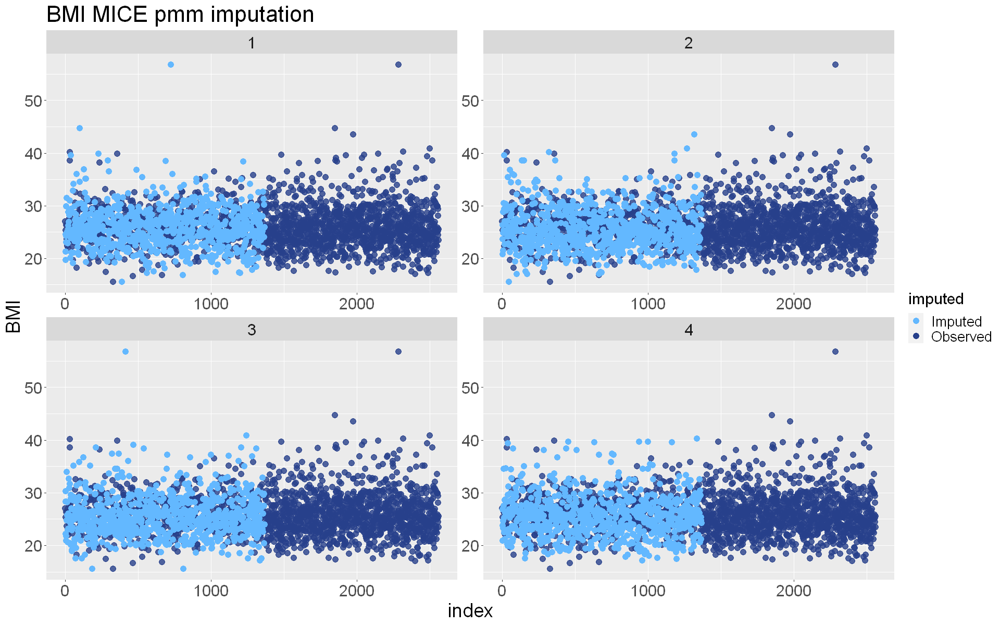

In [371]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "BMI", "MICE pmm")

In [23]:
method7_cls <- rep("", ncol(fram_mar))
method7_cls[c(5, 10, 13, 14, 15)] <- "pmm"

In [44]:
sim7 <- simulate(fram_mar, "TenYearCHD", 100, method7_cls, 5, 5, "pmm_mul.csv", intcols, fcols2)


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose
  1   2  cigsPerDay  totChol  BMI  heartRate  glucose
  1   3  cigsPerDay  totChol  BMI  heartRate  glucose
  1   4  cigsPerDay  totChol  BMI  heartRate  glucose
  1   5  cigsPerDay  totChol  BMI  heartRate  glucose
  2   1  cigsPerDay  totChol  BMI  heartRate  glucose
  2   2  cigsPerDay  totChol  BMI  heartRate  glucose
  2   3  cigsPerDay  totChol  BMI  heartRate  glucose
  2   4  cigsPerDay  totChol  BMI  heartRate  glucose
  2   5  cigsPerDay  totChol  BMI  heartRate  glucose
  3   1  cigsPerDay  totChol  BMI  heartRate  glucose
  3   2  cigsPerDay  totChol  BMI  heartRate  glucose
  3   3  cigsPerDay  totChol  BMI  heartRate  glucose
  3   4  cigsPerDay  totChol  BMI  heartRate  glucose
  3   5  cigsPerDay  totChol  BMI  heartRate  glucose
  4   1  cigsPerDay  totChol  BMI  heartRate  glucose
  4   2  cigsPerDay  totChol  BMI  heartRate  glucose
  4   3  cigsPerDay  totChol  BMI  heartRate  glucose
  4   4 

[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1887275; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3422952; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3422952; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.3422952; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: mmce.test.mean=0.4844776; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: mmce.test.mean=0.4844776

In [55]:
sim7

glm       knn        dt        rf 
0.5943975 0.7638028 0.8193114 0.8280282

##### KNN imputation

In [ ]:
train8 <- train
imp_train8 <- knnImputation(train8, scale=FALSE)

In [ ]:
test8 <- test
imp_test8 <- knnImputation(test8, scale=FALSE)

In [389]:
imp_train8[intcols] <- imp_train8[intcols] %>% lapply(as.integer)
imp_test8[intcols] <- imp_test8[intcols] %>% lapply(as.integer)

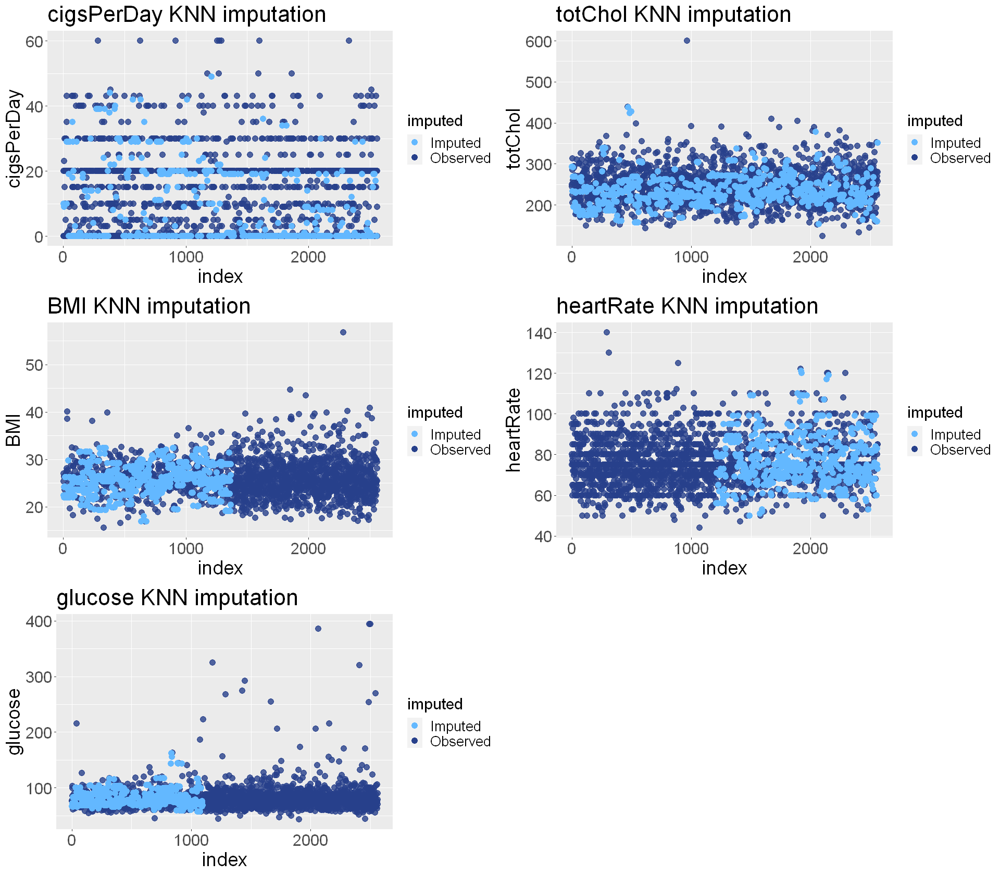

In [390]:
options(repr.plot.width = 16, repr.plot.height = 14)
plt1 <- visImpCont(train8, test8, imp_train8, imp_test8, "cigsPerDay", "KNN")
plt2 <- visImpCont(train8, test8, imp_train8, imp_test8, "totChol", "KNN")
plt3 <- visImpCont(train8, test8, imp_train8, imp_test8, "BMI", "KNN")
plt4 <- visImpCont(train8, test8, imp_train8, imp_test8, "heartRate", "KNN")
plt5 <- visImpCont(train8, test8, imp_train8, imp_test8, "glucose", "KNN")
plot_grid(plt1, plt2, plt3, plt4, plt5, ncol = 2)

In [18]:
sim8 <- simulate_knn(fram_mar, "TenYearCHD", 100, "knn.csv", intcols, fcols2)

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5

In [19]:
sim8

glm       knn        dt        rf 
0.5682473 0.7530047 0.7789045 0.8176213

##### MLMI

In [23]:
train9 <- train
test9 <- test
train_index <- train9$index
test_index <- test9$index
train9_noind <- subset(train9, select = -index)
test9_noind <- subset(test9, select = -index)

In [24]:
cattrain9 <- train9_noind[, !(names(train9_noind) %in% ccols)]
cattest9 <- test9_noind[, !(names(test9_noind) %in% ccols)]
conttrain9 <- train9_noind[, !(names(train9_noind) %in% colnames(cattrain9))]
conttest9 <- test9_noind[, !(names(test9_noind) %in% colnames(cattest9))]

In [25]:
train9_noind <- cbind(cattrain9, conttrain9)
test9_noind <- cbind(cattest9, conttest9)
train9_noind[] <- lapply(train9_noind, function(x) if(is.factor(x)) as.integer(x) else x)
test9_noind[] <- lapply(test9_noind, function(x) if(is.factor(x)) as.integer(x) else x)

In [26]:
imp_train9 <- mixImp(obsData = train9_noind, nCat = 8, M = 25, rseed = 1234)
imp_test9 <- mixImp(obsData = test9_noind, nCat = 8, M = 25, rseed = 1234)

Imputing categorical variables using all 2-way associations.

Imputing continuous variables assuming main effects of categorical variables



Steps of ECM: 
1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...


Imputing categorical variables using all 2-way associations.

Imputing continuous variables assuming main effects of categorical variables



Steps of ECM: 
1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...


In [27]:
imp_train9_df <- imp_train9[[1]]
imp_train9_df$.imp <- 1
imp_train9_df$index <- train_index
imp_test9_df <- imp_test9[[1]]
imp_test9_df$.imp <- 1
imp_test9_df$index <- test_index

for (i in 2:25) {
    imp_train_i <- imp_train9[[i]]
    imp_train_i$.imp <- i
    imp_train_i$index <- train_index
    imp_train9_df <- rbind(imp_train9_df, imp_train_i)

    imp_test_i <- imp_test9[[i]]
    imp_test_i$.imp <- i
    imp_test_i$index <- test_index
    imp_test9_df <- rbind(imp_test9_df, imp_test_i)
}

In [28]:
imp_train9_df[fcols] <- imp_train9_df[fcols] %>% lapply(factor)
imp_test9_df[fcols] <- imp_test9_df[fcols] %>% lapply(factor)

In [30]:
for (col in fcols) {
    imp_train9_df[[col]] <- ifelse(imp_train9_df[[col]] == 1, levels(fram_mar[[col]])[1], levels(fram_mar[[col]])[2])
    imp_test9_df[[col]] <- ifelse(imp_test9_df[[col]] == 1, levels(fram_mar[[col]])[1], levels(fram_mar[[col]])[2])
}

In [31]:
imp_train9_df[fcols] <- imp_train9_df[fcols] %>% lapply(factor)
imp_test9_df[fcols] <- imp_test9_df[fcols] %>% lapply(factor)

imp_train9_df[intcols] <- imp_train9_df[intcols] %>% lapply(as.integer)
imp_test9_df[intcols] <- imp_test9_df[intcols] %>% lapply(as.integer)

In [32]:
orgtest <- rbind(test9, test9, test9, test9)
orgtrain <- rbind(train9, train9, train9, train9)
imptest <- subset(imp_test9_df, .imp <= 4)
imptrain <- subset(imp_train9_df, .imp <= 4)

In [33]:
options(repr.plot.width = 16, repr.plot.height = 10)

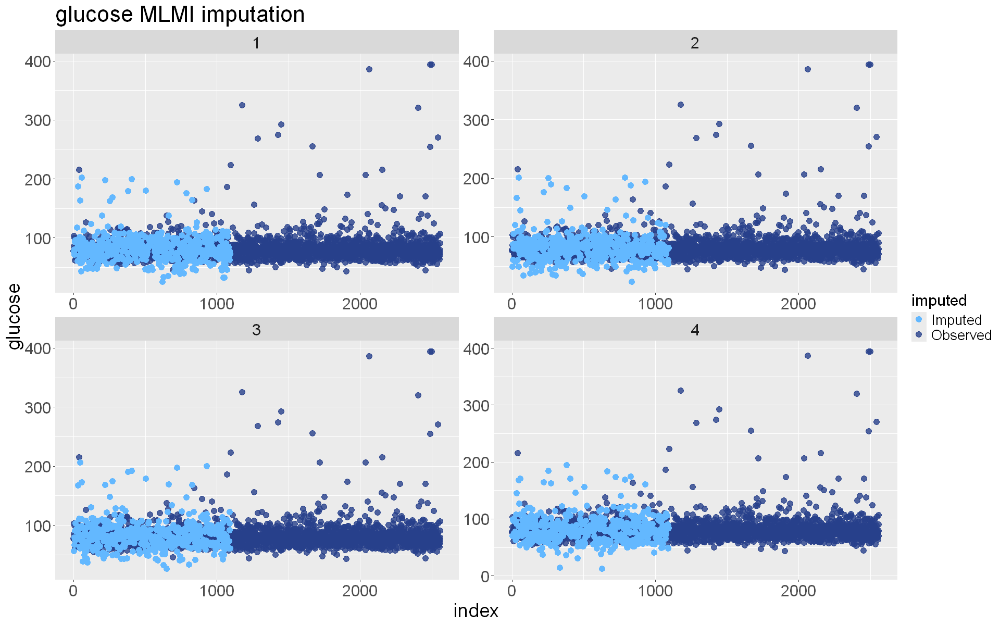

In [34]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "glucose", "MLMI")

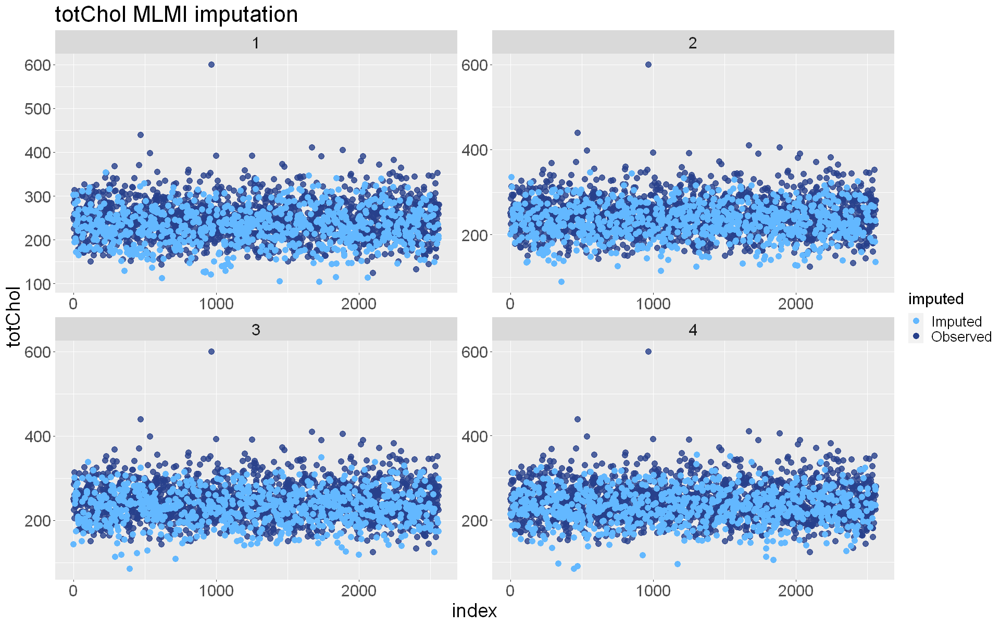

In [413]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "totChol", "MLMI")

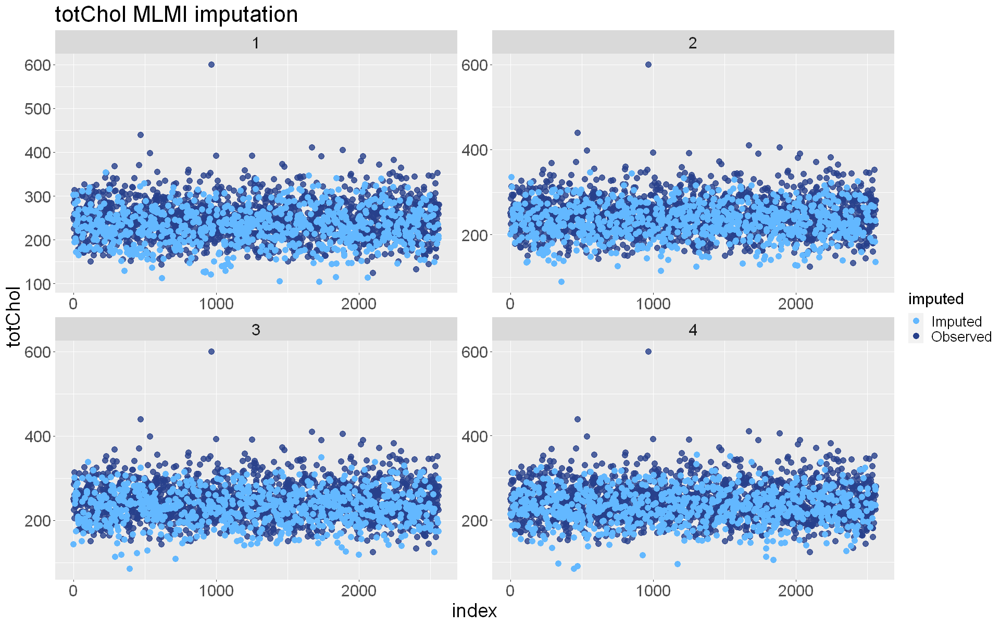

In [414]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "totChol", "MLMI")

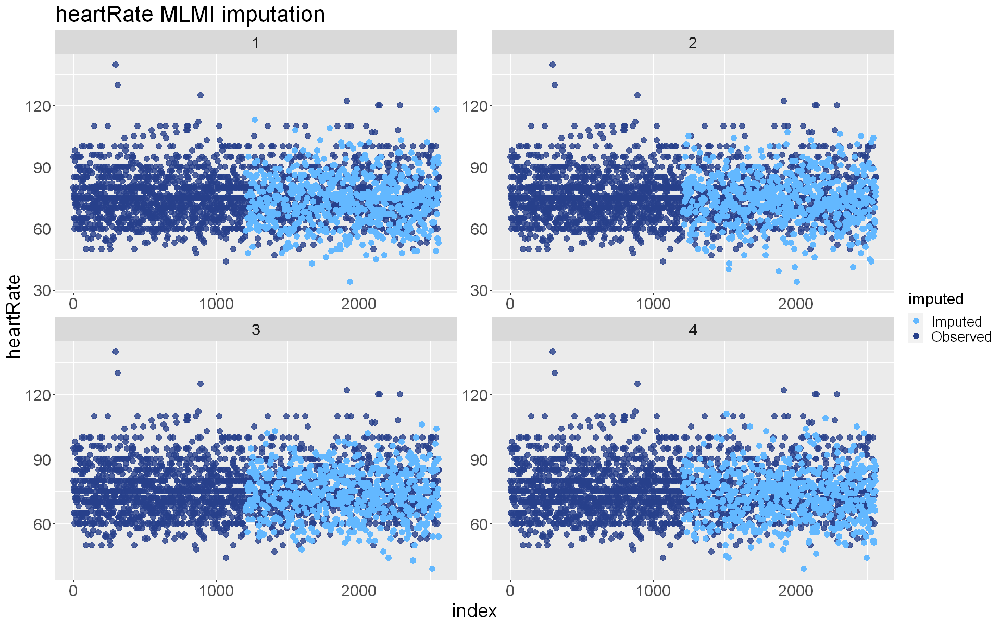

In [415]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "heartRate", "MLMI")

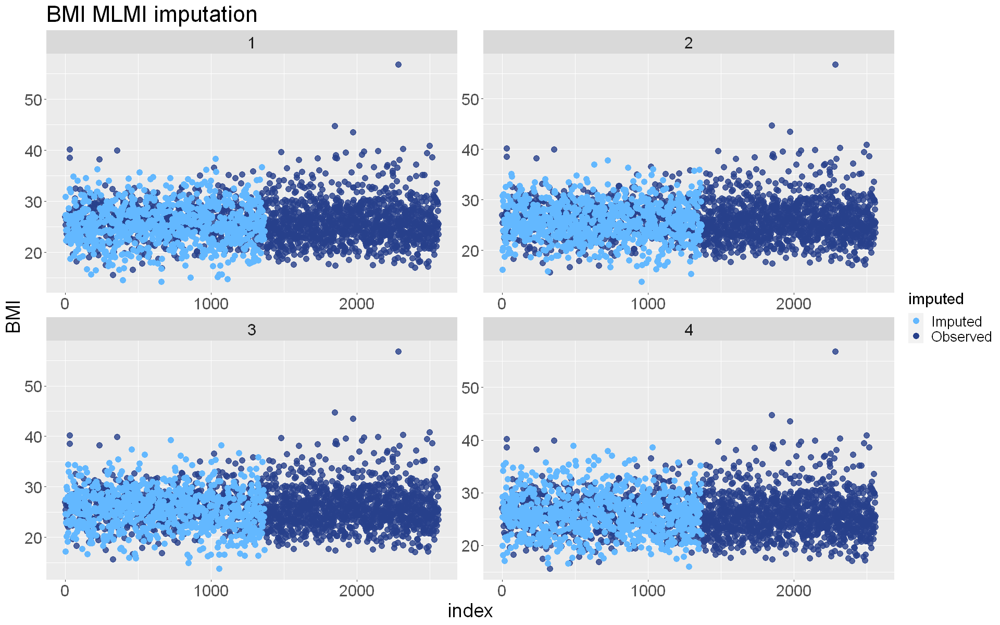

In [416]:
visImpMul(orgtrain, orgtest, imptrain, imptest, "BMI", "MLMI")

In [26]:
sim9 <- simulate_mlmi(fram_mar, "TenYearCHD", 100, 5, "mlmi.csv", intcols, fcols2, fcols)

Imputing categorical variables using all 2-way associations.

Imputing continuous variables assuming main effects of categorical variables



Steps of ECM: 
1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...


Imputing categorical variables using all 2-way associations.

Imputing continuous variables assuming main effects of categorical variables



Steps of ECM: 
1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...1

Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2088738; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3505559; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3505559; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.4445291; time: 0.0 min

[Tune-x] 5: cp=0

Steps of ECM: 
1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...


Imputing categorical variables using all 2-way associations.

Imputing continuous variables assuming main effects of categorical variables



Steps of ECM: 
1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.2084271; time: 0.0 min

[T

Steps of ECM: 
1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...


Imputing categorical variables using all 2-way associations.

Imputing continuous variables assuming main effects of categorical variables



Steps of ECM: 
1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: 1

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: mmce.test.mean=0.1989787; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: mmce.test.mean=0.3518393; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: mmce.test.mean=0.3518393; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: mmce.test.mean=0.4112788; time: 0.0 min

[Tune-x] 5: cp=0

In [36]:
sim9

V1        V2        V3        V4 
0.5552426 0.7693114 0.7917058 0.8252269

Decision tree imputation

In [432]:
train10 <- train
method10 <- rep("", ncol(train1))
method10[c(5, 10, 13, 14, 15)] <- "cart"
imp_train10 <- mice(train1, method=method1, m=1, maxit=1, predictorMatrix=predm_train) %>% complete()


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


In [433]:
test10 <- test
imp_test10 <- mice(test10, method=method10, m=1, maxit=1, predictorMatrix=predm_test) %>% complete()


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


In [434]:
imp_train10[intcols] <- imp_train10[intcols] %>% lapply(as.integer)
imp_test10[intcols] <- imp_test10[intcols] %>% lapply(as.integer)

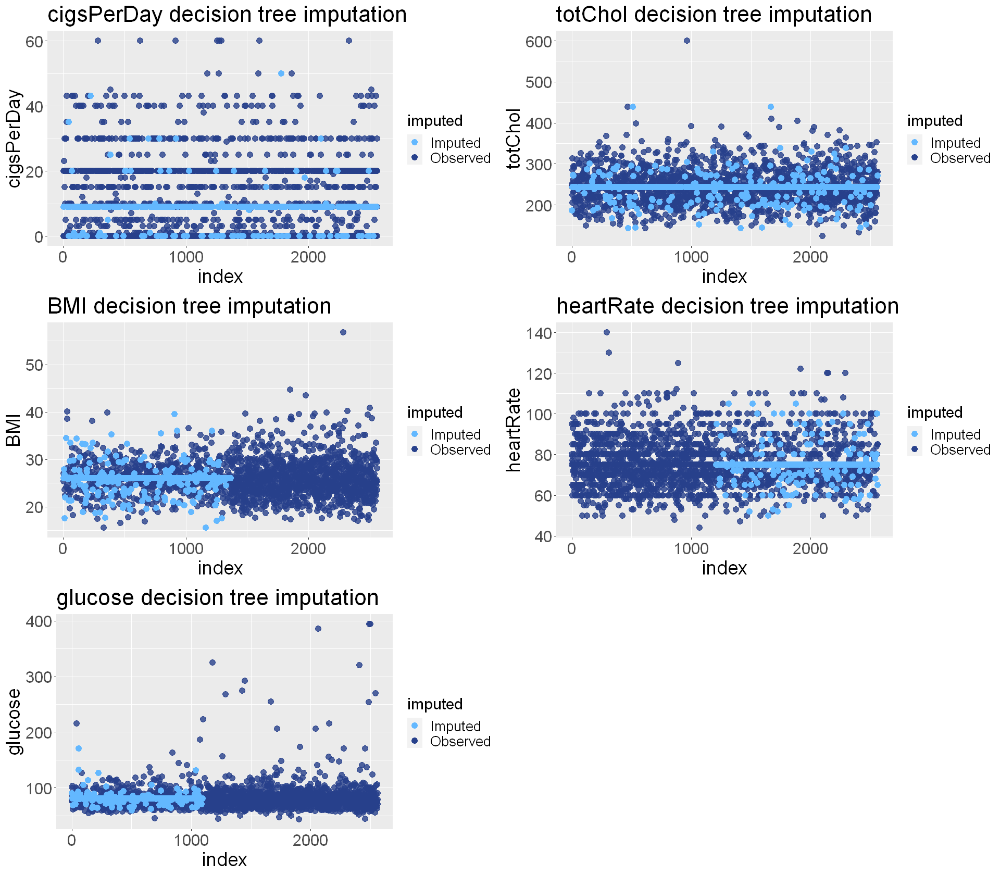

In [435]:
options(repr.plot.width = 16, repr.plot.height = 14)
plt1 <- visImpCont(train10, test10, imp_train10, imp_test10, "cigsPerDay", "decision tree")
plt2 <- visImpCont(train10, test10, imp_train10, imp_test10, "totChol", "decision tree")
plt3 <- visImpCont(train10, test10, imp_train10, imp_test10, "BMI", "decision tree")
plt4 <- visImpCont(train10, test10, imp_train10, imp_test10, "heartRate", "decision tree")
plt5 <- visImpCont(train10, test10, imp_train10, imp_test10, "glucose", "decision tree")
plot_grid(plt1, plt2, plt3, plt4, plt5, ncol = 2)

In [18]:
method10_cls <- rep("", ncol(fram_mar))
method10_cls[c(5, 10, 13, 14, 15)] <- "cart"

In [19]:
sim10 <- simulate(fram_mar, "TenYearCHD", 100, method10_cls, 1, 1, "dt.csv", intcols, fcols2)


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7897223; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6547307; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6547307; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6547307; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4903503; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4903503; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7972851; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6621418; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7970857; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6732329; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6732329; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6732329; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4912222; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, t


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7845386; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6595350; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7663093; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6542113; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6539051; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5415008; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4860643; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4860643; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7746224; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6643505; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6643505; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6250755; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5081571; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5081571; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7864263; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7641638; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6552100; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7951735; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6723982; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6723982; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6723982; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5088989; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, t


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7892866


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7721212; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6481818; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6481818; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5145455; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4915152; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7745202; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6633181; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6633181; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6633181; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4887330; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7777825; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6419160; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7765437; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6402302; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6402302; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5090480; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7904787


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7948485; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6615152; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6615152; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7659335; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7960366; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6548780; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6548780; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5481707; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7719084; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6741985; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6412214; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4851908; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4851908; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7890778; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6369892; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6369892; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4861196; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4861196; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4861196; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7960666; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6408472; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6408472; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5074130; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5074130; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5074130; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7998195; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6602614; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6602614; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5880624; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4954264; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7930303; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6660606; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6660606; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6272727; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8027698; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6606126; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6606126; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5623293; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5075638; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5075638; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7756987; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6508886; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6508886; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5091965; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5091965; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5091965; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7798762; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6609907; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6609907; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6269350; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7902446; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6650504; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6650504; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6650504; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, t


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7845921; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6404834; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6404834; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5290030; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5081571; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5081571; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7821571; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6471472; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6471472; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5060634; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5060634; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7888525; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6682799; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6682799; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6682799; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5068083; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7848406; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6524223; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7580113; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6144749; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6144749; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7825688; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6577982; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7869791; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 3"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7712679; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6334351; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6276336; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4909966; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4909966; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7979914; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6687883; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6687883; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6687883; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5062096; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8126316; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6637594; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7887473; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6515428; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6515428; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5518449; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5080095; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5080095; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7919778; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6301377; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8018780; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6718073; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6718073; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6718073; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5075625; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5075625; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7869917; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6466100; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6466100; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6027076; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7785180; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6526778; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6526778; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5268859; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7779434; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6533305; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6533305; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4926736; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4926736; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7736680; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6323207; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6323207; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5093446; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5093446; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5093446; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7763149; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6542604; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6542604; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7758218; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6435591; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6435591; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5057973; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4813698; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4813698; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7987879; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6521212; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6521212; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5909091; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5066667; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7972603; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6736682; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7956681; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6680696; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6680696; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 3"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7751209; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6374919; time: 0.0 min

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 3"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7756201; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6582784; time: 0.0 min

[Tune-x] 3: cp=0.21; mi


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7827668; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6562167; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6562167; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7786145; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6442771; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7959296; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6456268; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6456268; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4940773; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7978723; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6668693; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6668693; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6668693; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8179331; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6550152; time: 0.0 min

[Tune-x] 3: cp=0.21; mi


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7846754; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6664613; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6664613; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7825848; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6601737; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6601737; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5895497; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4862944; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7858082; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6705086; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6705086; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7909606; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7685006; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6463484; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6463484; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4803532; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4803532; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 3"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7782857; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6660576; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6660576; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7950392; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6684798; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6663618; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6240017; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4862403; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4862403; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7809811; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6738889; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6738889; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6738889; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5102328; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7801095; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6666708; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7845014; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6582932; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6582932; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5629391; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5072659; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5072659; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7670229; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7915187; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6744950; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6744950; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6744950; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7986722; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7792202; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7824264; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6831099; time: 0.0 min

[Tune-x] 3: cp=0.21; mi


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7839812; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6486688; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6486688; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6140709; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5060707; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5060707; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8081257; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6692969; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7869413; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6521247; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8085758; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6796325; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6796325; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6796325; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4823890; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7891403; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6603318; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7717132; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6675725; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7855238; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6604135; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7636360; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6405748; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6405748; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5041036; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5041036; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5041036; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7975018; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6585534; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6585534; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5849972; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5050177; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5050177; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7902198

In [20]:
sim10

glm       knn        dt        rf 
0.5728795 0.7538498 0.7806573 0.8158372

Random forest imputation

In [447]:
train11 <- train
method11 <- rep("", ncol(train11))
method11[c(5, 10, 13, 14, 15)] <- "rf"
imp_train11 <- mice(train11, method=method11, m=1, maxit=1, predictorMatrix=predm_train) %>% complete()


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


In [448]:
test11 <- test
imp_test11 <- mice(test11, method=method11, m=1, maxit=1, predictorMatrix=predm_test) %>% complete()


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


In [449]:
imp_train11[intcols] <- imp_train11[intcols] %>% lapply(as.integer)
imp_test11[intcols] <- imp_test11[intcols] %>% lapply(as.integer)

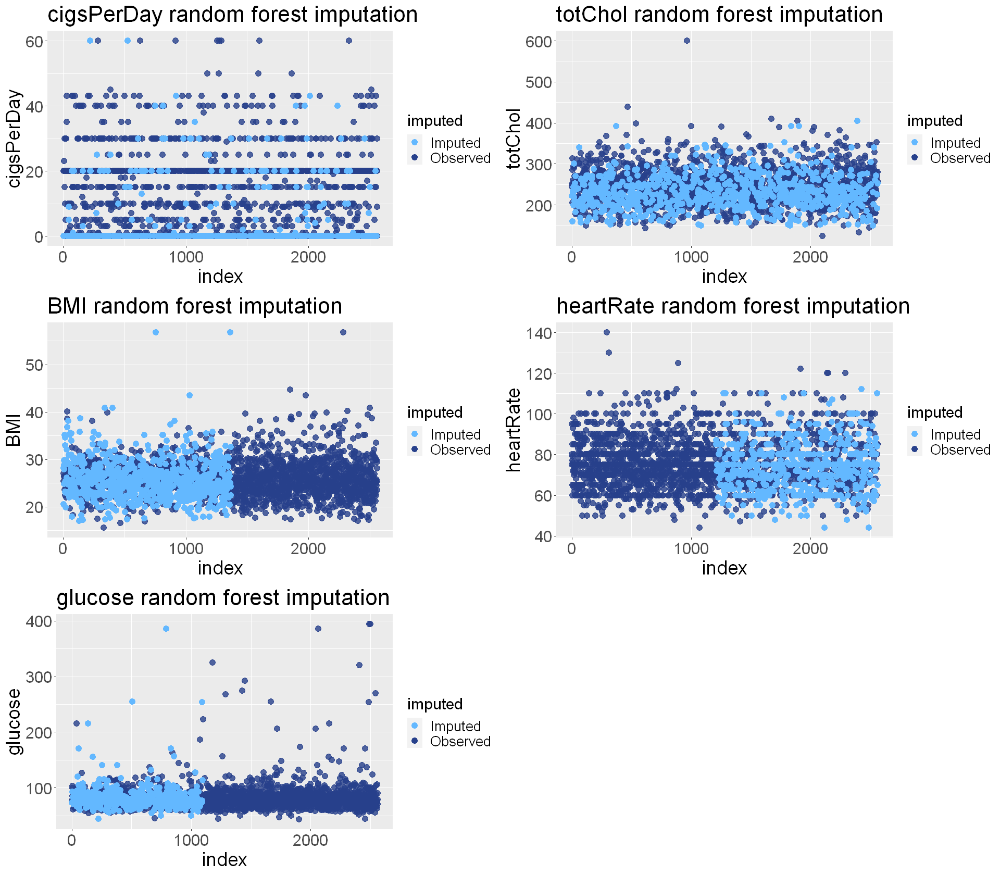

In [450]:
options(repr.plot.width = 16, repr.plot.height = 14)
plt1 <- visImpCont(train11, test11, imp_train11, imp_test11, "cigsPerDay", "random forest")
plt2 <- visImpCont(train11, test11, imp_train11, imp_test11, "totChol", "random forest")
plt3 <- visImpCont(train11, test11, imp_train11, imp_test11, "BMI", "random forest")
plt4 <- visImpCont(train11, test11, imp_train11, imp_test11, "heartRate", "random forest")
plt5 <- visImpCont(train11, test11, imp_train11, imp_test11, "glucose", "random forest")
plot_grid(plt1, plt2, plt3, plt4, plt5, ncol = 2)

In [21]:
method11_cls <- rep("", ncol(fram_mar))
method11_cls[c(5, 10, 13, 14, 15)] <- "rf"

In [22]:
sim11 <- simulate(fram_mar, "TenYearCHD", 100, method11_cls, 1, 1, "rf.csv", intcols, fcols2)


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7660303; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6466125; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6466125; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5053143; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5053143; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7728831; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6418537; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6308948; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4867770; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4867770; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4867770; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7964387; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6519835; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6519835; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5558015; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7885714; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6592481; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6592481; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5329323; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5103759; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5103759; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, t


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8119328; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6550603; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6550603; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4872828; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4872828; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7730789; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6336547; time: 0.0 min

[Tune-x] 3: cp=0.21; mi


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7965038; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6616492; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6616492; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7976816; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6666676; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6666676; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6666676; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4850647; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.5


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7959956; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6693982; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6693982; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6693982; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5057668; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for 


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7790288; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6604624; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6604624; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6172356; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

   


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7768645; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6572298; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6572298; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5549467; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4894977; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7905033; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6414738; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7803418; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6493369; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6493369; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5598031; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5108158; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5108158; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7949639; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6693907; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6693907; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6693907; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7780822; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6453577; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6453577; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6091324; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7757223; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6667707; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6667707; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6667707; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7935681; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6401225; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6401225; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6101072; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4839204; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4839204; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7408242; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6521529; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6521529; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5115633; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7801829; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6753049; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6753049; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6753049; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4939024; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7920748; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6673716; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6673716; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7819008; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6643251; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6643251; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6238380; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7790402; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6613525; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6613525; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7828547; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6645290; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6645290; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7932374; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6583936; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6583936; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5154462; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4873071; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4873071; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7681335; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6543247; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6543247; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4916540; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7746005; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6523830; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6523830; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5087559; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7937217; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6550920; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6550920; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4883620; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4883620; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4883620; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7743902; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6564024; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6564024; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5847561; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4932927; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4932927; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7674092; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6588620; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6588620; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5895056; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5050071; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7743418; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6785523; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6785523; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6785523; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4931754; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8017102; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6749142; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7801348; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6556494; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6556494; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5551529; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5069711; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7775237; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6377880; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6377880; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5303600; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5086078; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7975794


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7852780; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6642240; time: 0.0 min

[Tune-x] 3: cp=0.21; mi


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7874749; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6657667; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6657667; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7708165; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6545661; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6545661; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4907674; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7671132; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7810153; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6718242; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6718242; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6718242; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5062151; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5062151; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7965010; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6697667; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6697667; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6697667; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5099330; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5099330; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7934580; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6714152; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6635424; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5851135; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5069656; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7671603; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6505832; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6505832; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5239757; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7715867; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6319282; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6319282; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4904635; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4904635; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Sta


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7821190; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6633404; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6633404; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5887180; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4898785; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7855422; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6593373; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6593373; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5310241; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5096386; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7718561; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6530646; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6530646; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4919270; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4919270; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4919270; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7564459; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6601838; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7683022; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6173595; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6173595; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5075602; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5075602; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE  


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7753502; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6325783; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6325783; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5117090; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5117090; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7955325; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6653589; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6653589; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6653589; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7860606; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6493939; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6493939; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5815152; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7841000; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6510999; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6510999; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5868031; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5035620; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8024353; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6754947; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6754947; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6754947; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5044140; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5044140; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7851867; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6581315; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6581315; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5429409; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4887181; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4887181; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7988512; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6532725; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6532725; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5083079; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5083079; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5083079; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7832402; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6722919; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6722919; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6722919; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5091983; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5091983; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; m


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7791105; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6346856; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6346856; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5426463; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4948189; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7838823


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7966094; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6413478; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6413478; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5072608; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5072608; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.5072608; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 2"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8095781; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6601419; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6601419; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6601419; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5094945; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y]


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7804005; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6338952; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6254104; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5062174; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5062174; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7907561; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6596675; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6596675; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6183301; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5048692; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7878788; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6730303; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6730303; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6730303; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5066667; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8049352; time: 0.0 min

[T


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7996352; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6499624; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6499624; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5130884; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4848209; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4848209; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, s


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7873826; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6746780; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6746780; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6746780; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.5041156; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdep


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, t


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7965306; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6593352; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"Number of logged events: 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.8012140; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6676783; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6676783; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message:
"glm.fit: algorytm nie zbiegł się"
Warning message:
"glm.fit: dopasowane prawdopodobieństwa numerycznie okazały się być 0 lub 1"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7782477; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6456193; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.me


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7829795; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6682643; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6682643; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.6682643; time: 0.0 min

[Tune-x] 5: cp=0.41; minbucket=3; maxdepth=5

[Tune-y] 5: acc.test.mean=0.4913931; time: 0.0 min

[Tune-x] 6: cp=0.51; minbucket=3; maxdepth=5

[Tune-y] 6: acc.test.mean=0.4913931; tim


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7632893; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6412259; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tun


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7747258; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6370546; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6370546; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.4853468; time: 0.0 min

[Tune-x] 5: cp=0.41


 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose

 iter imp variable
  1   1  cigsPerDay  totChol  BMI  heartRate  glucose


Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
[Tune] Started tuning learner classif.rpart for parameter set:

              Type len Def                        Constr Req Tunable Trafo
cp        discrete   -   - 0.01,0.11,0.21,0.31,0.41,0.51   -    TRUE     -
minbucket discrete   -   -                        3,7,10   -    TRUE     -
maxdepth  discrete   -   -              5,10,15,20,25,30   -    TRUE     -

With control class: TuneControlGrid

Imputation value: -0

[Tune-x] 1: cp=0.01; minbucket=3; maxdepth=5

[Tune-y] 1: acc.test.mean=0.7683499; time: 0.0 min

[Tune-x] 2: cp=0.11; minbucket=3; maxdepth=5

[Tune-y] 2: acc.test.mean=0.6639569; time: 0.0 min

[Tune-x] 3: cp=0.21; minbucket=3; maxdepth=5

[Tune-y] 3: acc.test.mean=0.6639569; time: 0.0 min

[Tune-x] 4: cp=0.31; minbucket=3; maxdepth=5

[Tune-y] 4: acc.test.mean=0.5923779; time: 0.0 min

[Tune-x] 5: cp=0.41

In [23]:
sim11

glm       knn        dt        rf 
0.5432081 0.7466823 0.7768701 0.8161033